In [1]:
!pip install shap
!pip install lime


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import pandas as pd
import numpy as np
np.random.seed(0)
import matplotlib.pyplot as plt
import seaborn as sb

from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn import preprocessing
from sklearn.model_selection import train_test_split, GridSearchCV
import xgboost as xgb

import shap as shap
import time
import warnings

import lime
from lime.lime_tabular import LimeTabularExplainer

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Setup

In [3]:
df = pd.read_csv('day-bikesharing.csv',parse_dates=['dteday'],index_col=1) # Load the data

In [4]:
df.shape

(731, 15)

In [5]:
def add_features(df):
    df['year'] = df.index.year # yr exists already
    df['month'] = df.index.month
    df['day'] = df.index.day
    df['dayofweek'] = df.index.dayofweek

In [6]:
add_features(df)
df.head(3)

,instant,season,yr,mnth,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,year,month,day,dayofweek
dteday,,,,,,,,,,,,,,,,,,,
2011-01-01,1,1,0,1,0,6,0,2,0.344167,0.363625,0.805833,0.160446,331,654,985,2011,1,1,5
2011-01-02,2,1,0,1,0,0,0,2,0.363478,0.353739,0.696087,0.248539,131,670,801,2011,1,2,6
2011-01-03,3,1,0,1,0,1,1,1,0.196364,0.189405,0.437273,0.248309,120,1229,1349,2011,1,3,0


# We select meaningful variables for a better understanding of the SHAP results.

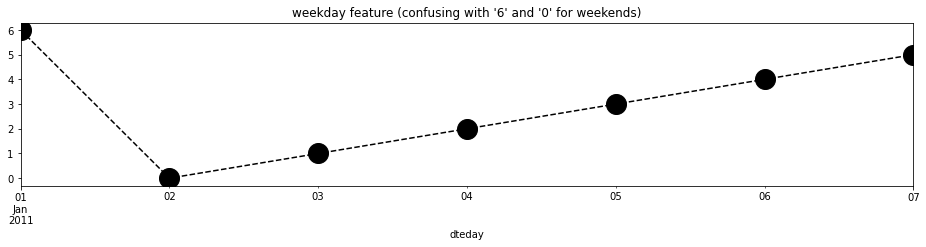

In [7]:
# Let's use 'dayofweek' instead of 'weekday'.
plt.figure(figsize=(16,3))
df['weekday'][:7].plot(linestyle='--', marker='o', color='k', ms=20, 
                       title='weekday feature (confusing with \'6\' and \'0\' for weekends)')
plt.show()

# We will use 'dayofweek' variable when describing each day of a week. Weekends of Saturday and Sunday are 5 and 6. The other weekdays are 0 to 4.

- When analyzing with SHAP, we consider higher numbers of 'dayofweek' feature to show the weekends.

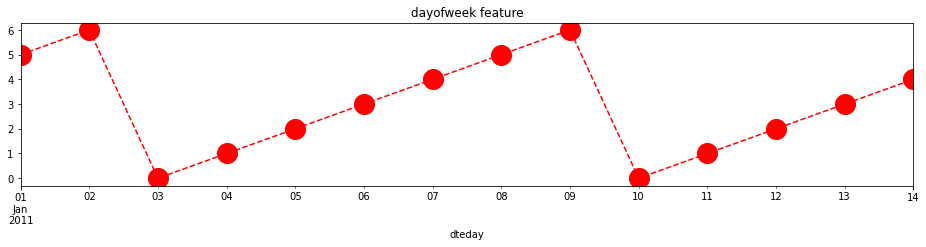

In [8]:
plt.figure(figsize=(16,3))
df['dayofweek'][:14].plot(linestyle='--', marker='o', color='r', ms=20, 
                       title='dayofweek feature')
plt.show()

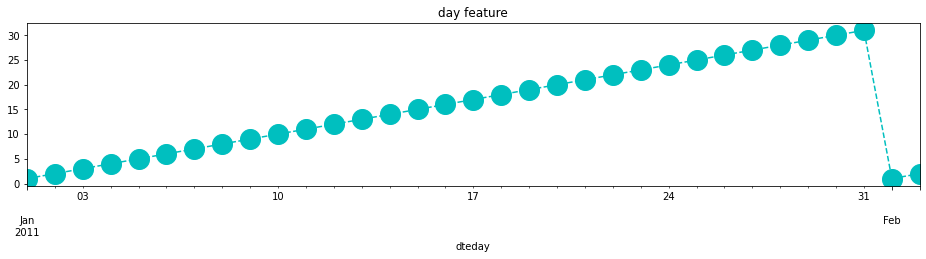

In [9]:
# Day feature shows whether it is a start of the month or the end of the month (1 to 30 or 31).
plt.figure(figsize=(16,3))
df['day'][:33].plot(linestyle='--', marker='o', color='c', ms=20, title='day feature')
plt.show()

# Workingday feature is a boolean. 

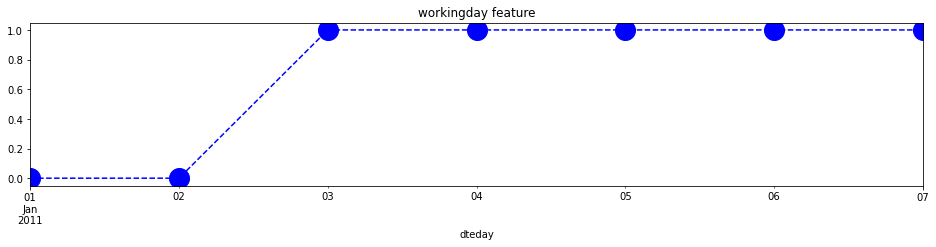

In [10]:
plt.figure(figsize=(16,3))
df['workingday'][:7].plot(linestyle='--', marker='o', color='b', ms=20, title='workingday feature')
plt.show()

# Note that season 1 indicates winter. Do you agree?

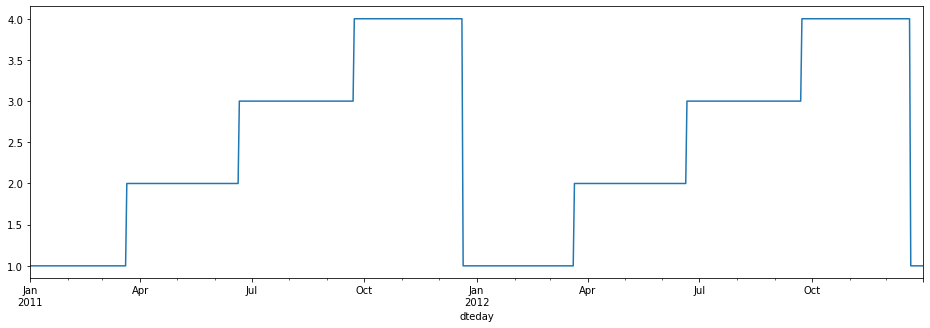

In [11]:
plt.figure(figsize=(16,5))
df['season'].plot()
plt.show()

In [12]:
df.season.value_counts()

3    188
2    184
1    181
4    178
Name: season, dtype: int64

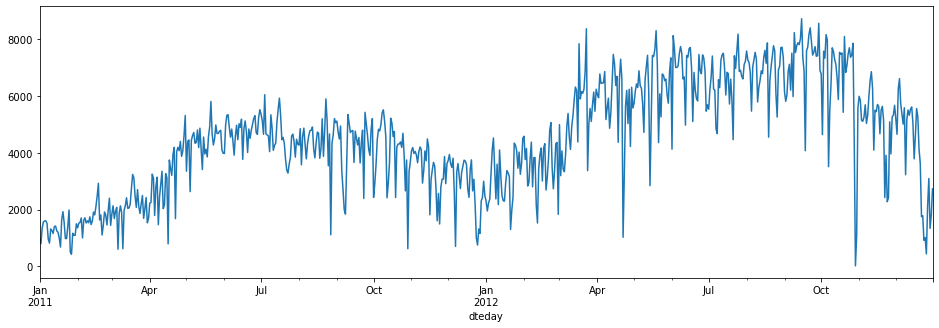

In [13]:
plt.figure(figsize=(16,5))
df['cnt'].plot()
plt.show()

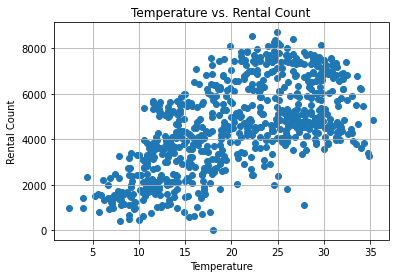

In [14]:
plt.scatter(x=df.temp*41,y=df["cnt"]) # denormalize temperature by multiplying 41
plt.grid(True)
plt.xlabel('Temperature')
plt.ylabel('Rental Count')
plt.title('Temperature vs. Rental Count')
plt.show()

Text(0.5, 1.0, 'Average Rental Count by Month')

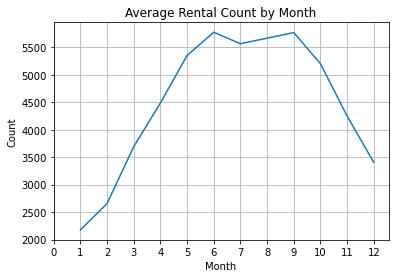

In [15]:
# from January to April, the demand is relatively low due to Winter 
#(there are not a lot of people that's brave enough to bike on icy road, are there?). 
# And the peak demand happends around Summer time (from May to October) and drop again.
group_month = df.groupby(['month'])
average_by_month = group_month['cnt'].mean()

plt.plot(average_by_month.index,average_by_month)
plt.xlabel('Month')
plt.ylabel('Count')
plt.xticks(np.arange(13))
plt.grid(True)
plt.title('Average Rental Count by Month')

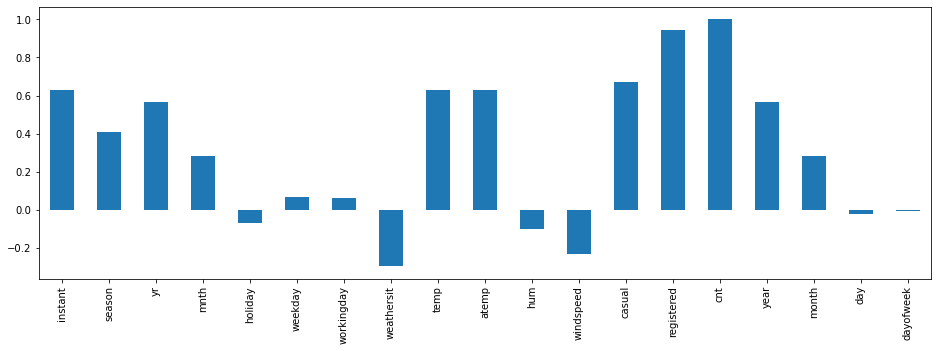

In [16]:
#correlation of total cnt with other variables
plt.figure(figsize=(16,5))
df.corr()['cnt'].plot(kind='bar')
plt.show()

In [17]:
#This is the normalized version.
# temp: The values are divided to 41 (max)
# atemp: The values are divided to 50 (max)
# hum: The values are divided to 100 (max)
# windspeed: The values are divided to 67 (max)
df.describe().T

,count,mean,std,min,25%,50%,75%,max
instant,731.0,366.000000,211.165812,1.000000,183.500000,366.000000,548.500000,731.000000
season,731.0,2.496580,1.110807,1.000000,2.000000,3.000000,3.000000,4.000000
yr,731.0,0.500684,0.500342,0.000000,0.000000,1.000000,1.000000,1.000000
mnth,731.0,6.519836,3.451913,1.000000,4.000000,7.000000,10.000000,12.000000
holiday,731.0,0.028728,0.167155,0.000000,0.000000,0.000000,0.000000,1.000000
weekday,731.0,2.997264,2.004787,0.000000,1.000000,3.000000,5.000000,6.000000
workingday,731.0,0.683995,0.465233,0.000000,0.000000,1.000000,1.000000,1.000000
weathersit,731.0,1.395349,0.544894,1.000000,1.000000,1.000000,2.000000,3.000000
temp,731.0,0.495385,0.183051,0.059130,0.337083,0.498333,0.655417,0.861667
atemp,731.0,0.474354,0.162961,0.079070,0.337842,0.486733,0.608602,0.840896


In [18]:
df.dtypes

instant         int64
season          int64
yr              int64
mnth            int64
holiday         int64
weekday         int64
workingday      int64
weathersit      int64
temp          float64
atemp         float64
hum           float64
windspeed     float64
casual          int64
registered      int64
cnt             int64
year            int64
month           int64
day             int64
dayofweek       int64
dtype: object

# Data cleaning

# Categorical variables

Perform one hot encoding on categorical variables. Machine learning algorithms assume (and require) the data to be numeric, so the categorical data must be pre-processed as a numerical data.  Categorical variables turn into binary features that are 'one hot' encoded, so if a feature is represented by that column, it receives a 1, otherwise a 0.

- The 'season' feature has 1: winter, 2: spring, 3: summer, 4: fall. 
- The 'holiday' and 'workingday' features are boolean: 1 when it is a holiday. 1 when it is a working day.

In [19]:
# Define the categorical variables
cat_var = ['season', 'holiday', 'workingday', 'weathersit', 'year']

In [20]:
# OneHotEncoder
ohe = OneHotEncoder(categories = 'auto')

In [21]:
# Fit the categorical variables to the encoder
encodeddf = ohe.fit_transform(df[cat_var])

In [22]:
# Create a DataFrame with the encoded value information
cat_df = pd.DataFrame(data = encodeddf.toarray(), columns = ohe.get_feature_names(cat_var))
cat_df

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.


,season_1,season_2,season_3,season_4,holiday_0,holiday_1,workingday_0,workingday_1,weathersit_1,weathersit_2,weathersit_3,year_2011,year_2012
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0


In [23]:
# rename the column names from 1,2,3,4 to spring, summer, fall, winter
cat_df.rename(columns={'season_1': 'winter', 'season_2': 'spring', 'season_3': 'summer', 'season_4': 'fall'}, inplace=True)
cat_df.rename(columns={'weathersit_1': 'clear', 'weathersit_2': 'cloudy', 'weathersit_3': 'lightsnow.rain'}, inplace=True)
cat_df

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0


# Numerical variables

Machine learning is sensitive to the relative scales of numerical variables. The range of all variables need to be normalized so that each feature contributes approximately proportionately to the calculation.

In [24]:
# Define the numerical variables
num_var = ['temp', 'atemp', 'hum', 'windspeed', 'month', 'day', 'dayofweek']

Create standardized, normalized

In [25]:
# StandardScaler object
scaler = StandardScaler()

In [26]:
# Fit the data to the scaler
numscaled = scaler.fit_transform(df[num_var])

Keep the original for later view

In [27]:
# for inverse transformation
inversed = scaler.inverse_transform(numscaled)
print(inversed)

[[ 0.344167  0.363625  0.805833 ...  1.        1.        5.      ]
 [ 0.363478  0.353739  0.696087 ...  1.        2.        6.      ]
 [ 0.196364  0.189405  0.437273 ...  1.        3.        0.      ]
 ...
 [ 0.253333  0.2424    0.752917 ... 12.       29.        5.      ]
 [ 0.255833  0.2317    0.483333 ... 12.       30.        6.      ]
 [ 0.215833  0.223487  0.5775   ... 12.       31.        0.      ]]


In [28]:
# Create DataFrame with original data
inversed_df = pd.DataFrame(data = inversed, columns = num_var)
inversed_df

# Calculate based on UCI info to retrieve the actual temperature and weather information
#temp : Normalized temperature in Celsius. The values are divided to 41 (max)
#atemp: Normalized feeling temperature in Celsius. The values are divided to 50 (max)
#hum: Normalized humidity. The values are divided to 100 (max)
#windspeed: Normalized wind speed. The values are divided to 67 (max)
inversed_origin = pd.concat([inversed_df.iloc[:,0] * 41, #temperature
           inversed_df.iloc[:,1] * 50,                   #feeling temperature
           inversed_df.iloc[:,2] * 100,                  #humidity
           inversed_df.iloc[:,3] * 67],                  #wind speed
          axis=1)
inversed_origin

,temp,atemp,hum,windspeed
0,14.110847,18.18125,80.5833,10.749882
1,14.902598,17.68695,69.6087,16.652113
2,8.050924,9.47025,43.7273,16.636703
3,8.200000,10.60610,59.0435,10.739832
4,9.305237,11.46350,43.6957,12.522300
...,...,...,...,...
726,10.420847,11.33210,65.2917,23.458911
727,10.386653,12.75230,59.0000,10.416557
728,10.386653,12.12000,75.2917,8.333661
729,10.489153,11.58500,48.3333,23.500518


Text(0.5, 0, 'daily time (# rows)')

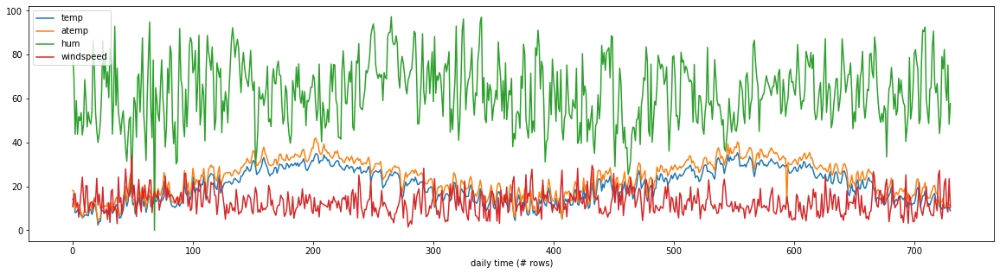

In [29]:
# timeseries of temp, atemp, humidity, windspeed
ax = inversed_origin.set_index(inversed_origin.index).plot(figsize=(20,5))
ax.set_xlabel('daily time (# rows)')

In [30]:
X_original = pd.concat([cat_df, inversed_origin, inversed_df[['month', 'day', 'dayofweek']]], axis=1)
X_original # Use this for SHAP plot view

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,14.110847,18.18125,80.5833,10.749882,1.0,1.0,5.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,14.902598,17.68695,69.6087,16.652113,1.0,2.0,6.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,8.050924,9.47025,43.7273,16.636703,1.0,3.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,8.200000,10.60610,59.0435,10.739832,1.0,4.0,1.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,9.305237,11.46350,43.6957,12.522300,1.0,5.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,10.420847,11.33210,65.2917,23.458911,12.0,27.0,3.0
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,10.386653,12.75230,59.0000,10.416557,12.0,28.0,4.0
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,10.386653,12.12000,75.2917,8.333661,12.0,29.0,5.0
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,10.489153,11.58500,48.3333,23.500518,12.0,30.0,6.0


In [31]:
# Create DataFrame with numerically scaled data
num_df = pd.DataFrame(data = numscaled, columns = num_var)
num_df

,temp,atemp,hum,windspeed,month,day,dayofweek
0,-0.826662,-0.679946,1.250171,-0.387892,-1.600161,-1.674108,0.996930
1,-0.721095,-0.740652,0.479113,0.749602,-1.600161,-1.560522,1.496077
2,-1.634657,-1.749767,-1.339274,0.746632,-1.600161,-1.446936,-1.498809
3,-1.614780,-1.610270,-0.263182,-0.389829,-1.600161,-1.333351,-0.999661
4,-1.467414,-1.504971,-1.341494,-0.046307,-1.600161,-1.219765,-0.500513
...,...,...,...,...,...,...,...
726,-1.318665,-1.521108,0.175807,2.061426,1.588660,1.279122,-0.001366
727,-1.323224,-1.346690,-0.266238,-0.452131,1.588660,1.392707,0.497782
728,-1.323224,-1.424344,0.878392,-0.853552,1.588660,1.506293,0.996930
729,-1.309558,-1.490049,-1.015664,2.069444,1.588660,1.619879,1.496077


Define X (input): Concatenate one hot encoded categorical + normalized numerical data

In [32]:
Xdf = pd.concat([cat_df, num_df], axis = 1)
print(Xdf.shape)
Xdf.head(5)

(731, 20)


,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-0.826662,-0.679946,1.250171,-0.387892,-1.600161,-1.674108,0.996930
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-0.721095,-0.740652,0.479113,0.749602,-1.600161,-1.560522,1.496077
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.634657,-1.749767,-1.339274,0.746632,-1.600161,-1.446936,-1.498809
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.614780,-1.610270,-0.263182,-0.389829,-1.600161,-1.333351,-0.999661
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.467414,-1.504971,-1.341494,-0.046307,-1.600161,-1.219765,-0.500513


In [33]:
# Save column names for SHAP usage
NAMES = Xdf.columns
NAMES

Index(['winter', 'spring', 'summer', 'fall', 'holiday_0', 'holiday_1',
       'workingday_0', 'workingday_1', 'clear', 'cloudy', 'lightsnow.rain',
       'year_2011', 'year_2012', 'temp', 'atemp', 'hum', 'windspeed', 'month',
       'day', 'dayofweek'],
      dtype='object')

<AxesSubplot:>

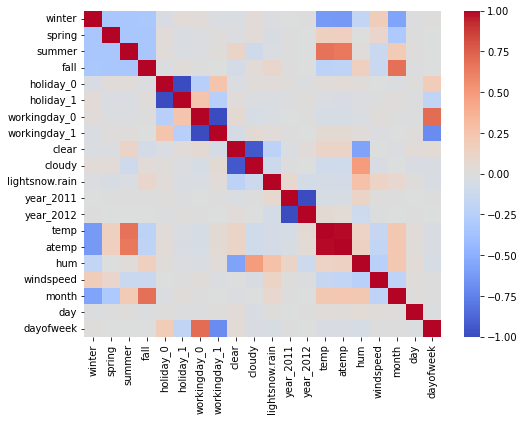

In [34]:
plt.subplots(figsize=(8, 6))
sb.heatmap(Xdf.corr(), cmap='coolwarm')

In [35]:
# Check if there is any non available
Xdf.isna().any().sum()

0

Define Y (to predict): Extract target

In [36]:
# Here, indicate which target to predict (cnt or casual or registered) 
# For the different models for each customer in the assignment, change the target 
to_predict = 'cnt'

In [37]:
# Here, indicate which target to predict (cnt or casual or registered) 
y = df[to_predict]

# Normalize target data: Calculate mean and standard deviation
y_mu = y.mean(0)
y_sd = y.std(0)

print('y mean:', y_mu, ' y std:' , y_sd)

y_norm = (y - y_mu) / y_sd
y_norm = y_norm.values.ravel() #dataframe to 1D array
#y_norm

y mean: 4504.3488372093025  y std: 1937.2114516187678


In [38]:
len(y)

731

In [39]:
# to verify, leave a whole dataframe with x and y together
tdf = pd.concat([Xdf, pd.DataFrame(y.values)], axis = 1)
tdf.rename(columns={0:'cnt'}, inplace=True) #change the column name
tdf

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,...,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek,cnt
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,1.0,0.0,-0.826662,-0.679946,1.250171,-0.387892,-1.600161,-1.674108,0.996930,985
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,1.0,0.0,-0.721095,-0.740652,0.479113,0.749602,-1.600161,-1.560522,1.496077,801
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,...,1.0,0.0,-1.634657,-1.749767,-1.339274,0.746632,-1.600161,-1.446936,-1.498809,1349
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,...,1.0,0.0,-1.614780,-1.610270,-0.263182,-0.389829,-1.600161,-1.333351,-0.999661,1562
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,...,1.0,0.0,-1.467414,-1.504971,-1.341494,-0.046307,-1.600161,-1.219765,-0.500513,1600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,...,0.0,1.0,-1.318665,-1.521108,0.175807,2.061426,1.588660,1.279122,-0.001366,2114
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,...,0.0,1.0,-1.323224,-1.346690,-0.266238,-0.452131,1.588660,1.392707,0.497782,3095
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,0.0,1.0,-1.323224,-1.424344,0.878392,-0.853552,1.588660,1.506293,0.996930,1341
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,-1.309558,-1.490049,-1.015664,2.069444,1.588660,1.619879,1.496077,1796


Split training and test data

In [40]:
# Split the data into training, validation, and test data:
X_train, X_test, y_train, y_test = train_test_split(Xdf, y_norm, test_size = 0.2, random_state=1)
# Validation set
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=1)

# Grid search and modeling

In [41]:
# A parameter grid for XGBoost
params = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5]
        }

In [42]:
# Build the model with 
# XGBoost Training Parameter Reference: 
#   https://github.com/dmlc/xgboost
#   https://xgboost.readthedocs.io/en/latest/parameter.html

# XGBRegressor object and GridSearch object
xgbmodel = xgb.XGBRegressor() 
clf = GridSearchCV(estimator = xgbmodel,
                   param_grid = params,
                   cv = 3,
                   verbose=1)

In [43]:
# Fit the training data to the GridSearch object
t0 = time.time()
clf.fit(X_train, y_train)
t1 = time.time()
print(t1-t0, " sec taken")

Fitting 3 folds for each of 405 candidates, totalling 1215 fits
74.44432950019836  sec taken


In [44]:
# Display the best parameters from the GridSearch
# Let's assume that this is a good enough model to use for SHAP
print(clf.best_params_)
print(clf.best_score_)

{'colsample_bytree': 0.8, 'gamma': 0.5, 'max_depth': 4, 'min_child_weight': 5, 'subsample': 0.8}
0.8633448414950647


# Train with best parameters

In [45]:
from sklearn._config import get_config, set_config
set_config(print_changed_only=False)

In [46]:
xgbmodel = xgb.XGBRegressor(**clf.best_params_, random_state=0)

In [47]:
# Fit the training data to the model
xgbmodel.fit(X_train, y_train, eval_set = [(X_train, y_train), (X_val, y_val)])

[0]	validation_0-rmse:0.84811	validation_1-rmse:0.86342
[1]	validation_0-rmse:0.67246	validation_1-rmse:0.69370
[2]	validation_0-rmse:0.54534	validation_1-rmse:0.58267
[3]	validation_0-rmse:0.45971	validation_1-rmse:0.50922
[4]	validation_0-rmse:0.40182	validation_1-rmse:0.45342
[5]	validation_0-rmse:0.36729	validation_1-rmse:0.40947
[6]	validation_0-rmse:0.33601	validation_1-rmse:0.38506
[7]	validation_0-rmse:0.31756	validation_1-rmse:0.37200
[8]	validation_0-rmse:0.30014	validation_1-rmse:0.36170
[9]	validation_0-rmse:0.28967	validation_1-rmse:0.35561
[10]	validation_0-rmse:0.28115	validation_1-rmse:0.34970
[11]	validation_0-rmse:0.27210	validation_1-rmse:0.34349
[12]	validation_0-rmse:0.27027	validation_1-rmse:0.33654
[13]	validation_0-rmse:0.26416	validation_1-rmse:0.33288
[14]	validation_0-rmse:0.25919	validation_1-rmse:0.33080
[15]	validation_0-rmse:0.25919	validation_1-rmse:0.33081
[16]	validation_0-rmse:0.25706	validation_1-rmse:0.32948
[17]	validation_0-rmse:0.25709	validation

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=0.8,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=0.5, gpu_id=-1,
             grow_policy='depthwise', importance_type=None,
             interaction_constraints='', learning_rate=0.300000012, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=4, max_leaves=0, min_child_weight=5, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, objective='reg:squarederror',
             predictor='auto', ...)

# Predict

In [48]:
eval_result = xgbmodel.evals_result()
training_rounds = range(len(eval_result['validation_0']['rmse'])) #training
print(training_rounds)

range(0, 100)


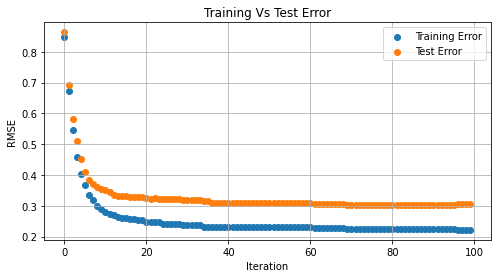

In [49]:
plt.figure(figsize=(8,4))
plt.scatter(x=training_rounds,y=eval_result['validation_0']['rmse'],label='Training Error')
plt.scatter(x=training_rounds,y=eval_result['validation_1']['rmse'],label='Test Error')
plt.grid(True)
plt.xlabel('Iteration')
plt.ylabel('RMSE')
plt.title('Training Vs Test Error')
plt.legend()
plt.show()

In [50]:
ypredicted = xgbmodel.predict(X_test)

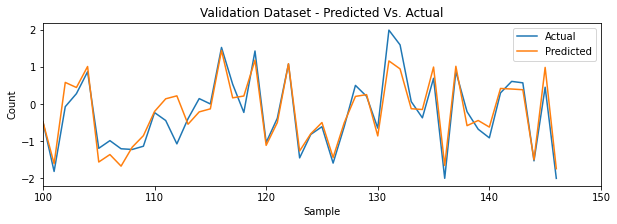

In [51]:
plt.figure(figsize=(10,3))
# Actual Vs Predicted
plt.plot(y_test, label='Actual')
plt.plot(ypredicted, label='Predicted')
plt.xlabel('Sample')
plt.ylabel('Count')
plt.xlim([100,150])
plt.title('Validation Dataset - Predicted Vs. Actual')
plt.legend()
plt.show()

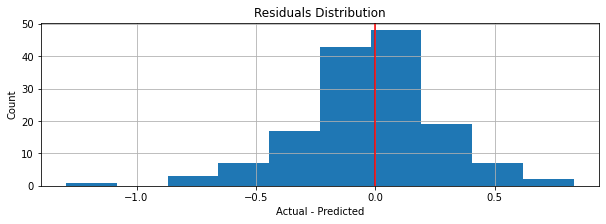

In [52]:
# Over prediction and Under Prediction needs to be balanced
# Training Data Residuals
residuals = (y_test - ypredicted) # * y_sd + y_mu (for actual cnt numbers)

plt.figure(figsize=(10,3))
plt.hist(residuals)
plt.grid(True)
plt.xlabel('Actual - Predicted')
plt.ylabel('Count')
plt.title('Residuals Distribution')
plt.axvline(color='r')
plt.show()

In [53]:
print("RMSE: {0:0.4f}".format(mean_squared_error(y_test, ypredicted)))

RMSE: 0.0884


The RMSE score looks good. So, the model is good for the SHAP evaluation.

In [54]:
# Show the influencing features in order (with feature_importances_)
# Indicate which parameter used to decide the ranking of important features
important_features = pd.Series(data=xgbmodel.feature_importances_, index=NAMES)
important_features.sort_values(ascending=False,inplace=True)
print(important_features)

# There are different parameters:
# Refer to, https://github.com/dmlc/xgboost/blob/master/python-package/xgboost/core.py
#        * 'weight': the number of times a feature is used to split the data across all trees.
#        * 'gain': the average gain across all splits the feature is used in.
#        * 'cover': the average coverage across all splits the feature is used in.
#        * 'total_gain': the total gain across all splits the feature is used in.
#        * 'total_cover': the total coverage across all splits the feature is used in.

year_2012         0.334441
month             0.148238
year_2011         0.093973
atemp             0.091646
winter            0.060549
fall              0.057606
clear             0.034687
cloudy            0.033488
temp              0.031691
lightsnow.rain    0.028922
hum               0.022926
windspeed         0.017095
workingday_0      0.010901
holiday_0         0.009047
day               0.007691
dayofweek         0.007369
workingday_1      0.007166
spring            0.002563
holiday_1         0.000000
summer            0.000000
dtype: float32


In [55]:
important_features = pd.Series(data=xgbmodel.get_booster().get_score(importance_type='gain'), index=NAMES)
important_features.sort_values(ascending=False,inplace=True)
print(important_features)

year_2012         24.965616
month             11.065815
year_2011          7.015013
atemp              6.841238
winter             4.519948
fall               4.300218
clear              2.589336
cloudy             2.499859
temp               2.365730
lightsnow.rain     2.159016
hum                1.711424
windspeed          1.276122
workingday_0       0.813745
holiday_0          0.675331
day                0.574106
dayofweek          0.550102
workingday_1       0.534939
spring             0.191319
summer                  NaN
holiday_1               NaN
dtype: float64


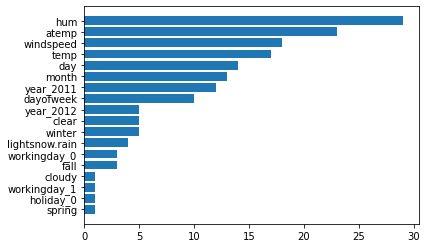

In [56]:
# Show the influencing features in order (with get_booster().get_fscore())
# fscore is based on the number of times a feature is used in a tree
fscore = xgbmodel.get_booster().get_fscore().items()
lists = sorted(fscore, key=lambda x:x[1]) # sorted by value, return a list of tuples
fkey, fvalue = zip(*lists) # unpack a list of pairs into two tuples

plt.barh(fkey, fvalue)
plt.show()

Now, I am going to create model to predict casual customers

In [57]:
# Defining 'casual' as the target variable to predict
to_predict = 'casual'

y1 = df[to_predict]

# Normalize target data: Calculate mean and standard deviation
y_mu1 = y1.mean(0)
y_sd1 = y1.std(0)

print('y mean:', y_mu1, ' y std:' , y_sd1)

y mean: 848.1764705882352  y std: 686.6224882846549


In [58]:
y_norm1 = (y1 - y_mu1) / y_sd1
y_norm1 = y_norm1.values.ravel() #dataframe to 1D array
#y_norm

len(y1)

731

In [59]:
# to verify, leave a whole dataframe with x and y together
tdf = pd.concat([Xdf, pd.DataFrame(y1.values)], axis = 1)
tdf.rename(columns={0:'casual'}, inplace=True)
tdf

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,...,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek,casual
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,1.0,0.0,-0.826662,-0.679946,1.250171,-0.387892,-1.600161,-1.674108,0.996930,331
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,1.0,0.0,-0.721095,-0.740652,0.479113,0.749602,-1.600161,-1.560522,1.496077,131
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,...,1.0,0.0,-1.634657,-1.749767,-1.339274,0.746632,-1.600161,-1.446936,-1.498809,120
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,...,1.0,0.0,-1.614780,-1.610270,-0.263182,-0.389829,-1.600161,-1.333351,-0.999661,108
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,...,1.0,0.0,-1.467414,-1.504971,-1.341494,-0.046307,-1.600161,-1.219765,-0.500513,82
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,...,0.0,1.0,-1.318665,-1.521108,0.175807,2.061426,1.588660,1.279122,-0.001366,247
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,...,0.0,1.0,-1.323224,-1.346690,-0.266238,-0.452131,1.588660,1.392707,0.497782,644
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,0.0,1.0,-1.323224,-1.424344,0.878392,-0.853552,1.588660,1.506293,0.996930,159
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,-1.309558,-1.490049,-1.015664,2.069444,1.588660,1.619879,1.496077,364


Split training and test data

In [60]:
# Split the data into training, validation, and test data:
X_train1, X_test1, y_train1, y_test1 = train_test_split(Xdf, y_norm1, test_size = 0.2, random_state=1)
# Validation set
X_train1, X_val1, y_train1, y_val1 = train_test_split(X_train1, y_train1, test_size=0.2, random_state=1)

# Grid search and modeling

In [61]:
# A parameter grid for XGBoost
params = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5]
        }

In [62]:
# XGBRegressor object and GridSearch object
xgbmodel1 = xgb.XGBRegressor() 
clf = GridSearchCV(estimator = xgbmodel1,
                   param_grid = params,
                   cv = 3,
                   verbose=1)

In [63]:
# Fit the training data to the GridSearch object
t0 = time.time()
clf.fit(X_train1, y_train1)
t1 = time.time()
print(t1-t0, " sec taken")

Fitting 3 folds for each of 405 candidates, totalling 1215 fits
76.52220702171326  sec taken


In [64]:
# Display the best parameters from the GridSearch
# Let's assume that this is a good enough model to use for SHAP
print(clf.best_params_)
print(clf.best_score_)

{'colsample_bytree': 0.8, 'gamma': 0.5, 'max_depth': 4, 'min_child_weight': 1, 'subsample': 0.8}
0.8589632479235166


In [65]:
# Train with best parameters

from sklearn._config import get_config, set_config
set_config(print_changed_only=False)

xgbmodel1 = xgb.XGBRegressor(**clf.best_params_, random_state=0)

In [66]:
# Fit the training data to the model
xgbmodel1.fit(X_train1, y_train1, eval_set = [(X_train1, y_train1), (X_val1, y_val1)])

[0]	validation_0-rmse:0.87241	validation_1-rmse:0.88510
[1]	validation_0-rmse:0.67644	validation_1-rmse:0.72826
[2]	validation_0-rmse:0.54821	validation_1-rmse:0.63458
[3]	validation_0-rmse:0.46086	validation_1-rmse:0.58443
[4]	validation_0-rmse:0.40591	validation_1-rmse:0.54846
[5]	validation_0-rmse:0.36740	validation_1-rmse:0.51408
[6]	validation_0-rmse:0.34118	validation_1-rmse:0.50096
[7]	validation_0-rmse:0.32333	validation_1-rmse:0.49024
[8]	validation_0-rmse:0.30963	validation_1-rmse:0.47857
[9]	validation_0-rmse:0.29648	validation_1-rmse:0.47471
[10]	validation_0-rmse:0.28011	validation_1-rmse:0.47321
[11]	validation_0-rmse:0.27296	validation_1-rmse:0.47027
[12]	validation_0-rmse:0.26916	validation_1-rmse:0.46697
[13]	validation_0-rmse:0.26275	validation_1-rmse:0.46912
[14]	validation_0-rmse:0.25897	validation_1-rmse:0.47089
[15]	validation_0-rmse:0.25614	validation_1-rmse:0.46965
[16]	validation_0-rmse:0.25390	validation_1-rmse:0.47174
[17]	validation_0-rmse:0.25390	validation

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=0.8,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=0.5, gpu_id=-1,
             grow_policy='depthwise', importance_type=None,
             interaction_constraints='', learning_rate=0.300000012, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=4, max_leaves=0, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, objective='reg:squarederror',
             predictor='auto', ...)

# Predict

In [67]:
eval_result = xgbmodel1.evals_result()
training_rounds = range(len(eval_result['validation_0']['rmse'])) #training
print(training_rounds)

range(0, 100)


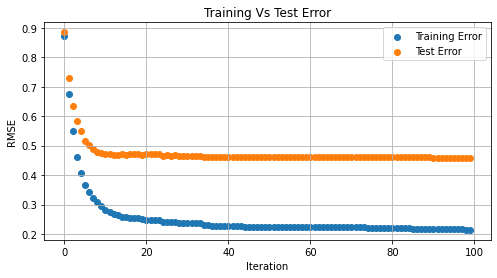

In [68]:
plt.figure(figsize=(8,4))
plt.scatter(x=training_rounds,y=eval_result['validation_0']['rmse'],label='Training Error')
plt.scatter(x=training_rounds,y=eval_result['validation_1']['rmse'],label='Test Error')
plt.grid(True)
plt.xlabel('Iteration')
plt.ylabel('RMSE')
plt.title('Training Vs Test Error')
plt.legend()
plt.show()

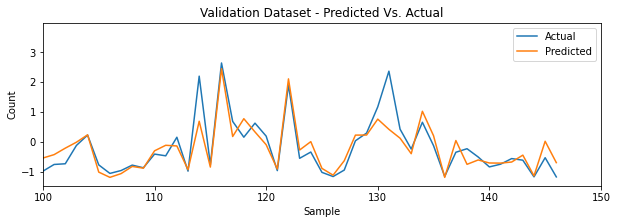

In [69]:
ypredicted = xgbmodel1.predict(X_test1)

plt.figure(figsize=(10,3))
# Actual Vs Predicted
plt.plot(y_test1, label='Actual')
plt.plot(ypredicted, label='Predicted')
plt.xlabel('Sample')
plt.ylabel('Count')
plt.xlim([100,150])
plt.title('Validation Dataset - Predicted Vs. Actual')
plt.legend()
plt.show()

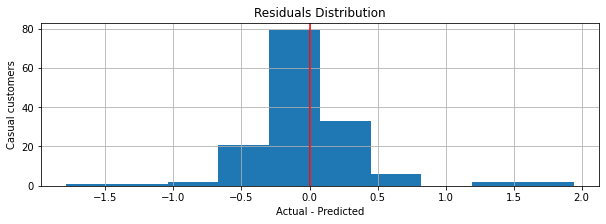

In [70]:
# Over prediction and Under Prediction needs to be balanced
# Training Data Residuals
residuals = (y_test1 - ypredicted) # * y_sd1 + y_mu1 (for actual casual customers)

plt.figure(figsize=(10,3))
plt.hist(residuals)
plt.grid(True)
plt.xlabel('Actual - Predicted')
plt.ylabel('Casual customers')
plt.title('Residuals Distribution')
plt.axvline(color='r')
plt.show()

In [71]:
print("RMSE: {0:0.4f}".format(mean_squared_error(y_test1, ypredicted)))

RMSE: 0.1744


The RMSE score looks good. So, the model is good for the SHAP evaluation.

In [72]:
# Show the influencing features in order (with feature_importances_)
# Indicate which parameter used to decide the ranking of important features
important_features = pd.Series(data=xgbmodel1.feature_importances_, index=NAMES)
important_features.sort_values(ascending=False,inplace=True)
print(important_features)

workingday_0      0.293897
month             0.223138
atemp             0.093890
clear             0.081260
year_2012         0.052790
summer            0.052426
year_2011         0.042236
temp              0.032361
hum               0.030084
lightsnow.rain    0.019918
dayofweek         0.016602
holiday_0         0.014512
windspeed         0.013845
day               0.010773
spring            0.009136
holiday_1         0.008044
cloudy            0.005088
workingday_1      0.000000
fall              0.000000
winter            0.000000
dtype: float32


In [73]:
important_features = pd.Series(data=xgbmodel1.get_booster().get_score(importance_type='gain'), index=NAMES)
important_features.sort_values(ascending=False,inplace=True)
print(important_features)

workingday_0      18.548418
month             14.082705
atemp              5.925561
clear              5.128498
year_2012          3.331682
summer             3.308685
year_2011          2.665622
temp               2.042361
hum                1.898643
lightsnow.rain     1.257055
dayofweek          1.047768
holiday_0          0.915852
windspeed          0.873806
day                0.679901
spring             0.576615
holiday_1          0.507697
cloudy             0.321132
winter                  NaN
fall                    NaN
workingday_1            NaN
dtype: float64


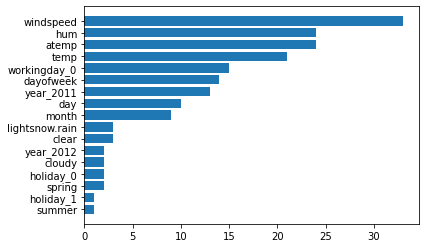

In [74]:
# Show the influencing features in order (with get_booster().get_fscore())
# fscore is based on the number of times a feature is used in a tree
fscore = xgbmodel1.get_booster().get_fscore().items()
lists = sorted(fscore, key=lambda x:x[1]) # sorted by value, return a list of tuples
fkey, fvalue = zip(*lists) # unpack a list of pairs into two tuples

plt.barh(fkey, fvalue)
plt.show()

Now, I am going to create model to predict registered customers.

Define Y (to predict): Extract target

In [75]:
# Here, indicate which target to predict (cnt or casual or registered) 
# For the different models for each customer in the assignment, change the target 
to_predict = 'registered'

# Here, indicate which target to predict (cnt or casual or registered) 
y2 = df[to_predict]

# Normalize target data: Calculate mean and standard deviation
y_mu2 = y2.mean(0)
y_sd2 = y2.std(0)

print('y mean:', y_mu2, ' y std:' , y_sd2)

y mean: 3656.172366621067  y std: 1560.2563770194527


In [76]:
y_norm2 = (y2 - y_mu2) / y_sd2
y_norm2 = y_norm2.values.ravel() #dataframe to 1D array
#y_norm

len(y2)

731

In [77]:
# to verify, leave a whole dataframe with x and y together
tdf = pd.concat([Xdf, pd.DataFrame(y2.values)], axis = 1)
tdf.rename(columns={0:'registered'}, inplace=True)
tdf

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,...,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek,registered
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,1.0,0.0,-0.826662,-0.679946,1.250171,-0.387892,-1.600161,-1.674108,0.996930,654
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,1.0,0.0,-0.721095,-0.740652,0.479113,0.749602,-1.600161,-1.560522,1.496077,670
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,...,1.0,0.0,-1.634657,-1.749767,-1.339274,0.746632,-1.600161,-1.446936,-1.498809,1229
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,...,1.0,0.0,-1.614780,-1.610270,-0.263182,-0.389829,-1.600161,-1.333351,-0.999661,1454
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,...,1.0,0.0,-1.467414,-1.504971,-1.341494,-0.046307,-1.600161,-1.219765,-0.500513,1518
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,...,0.0,1.0,-1.318665,-1.521108,0.175807,2.061426,1.588660,1.279122,-0.001366,1867
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,...,0.0,1.0,-1.323224,-1.346690,-0.266238,-0.452131,1.588660,1.392707,0.497782,2451
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,0.0,1.0,-1.323224,-1.424344,0.878392,-0.853552,1.588660,1.506293,0.996930,1182
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,-1.309558,-1.490049,-1.015664,2.069444,1.588660,1.619879,1.496077,1432


In [78]:
# Split the data into training, validation, and test data:
X_train2, X_test2, y_train2, y_test2 = train_test_split(Xdf, y_norm2, test_size = 0.2, random_state=1)
# Validation set
X_train2, X_val2, y_train2, y_val2 = train_test_split(X_train2, y_train2, test_size=0.2, random_state=1)

In [79]:
# Grid search and modeling

# A parameter grid for XGBoost
params = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5]
        }

In [80]:
# Build the model with 
# XGBRegressor object and GridSearch object
xgbmodel2 = xgb.XGBRegressor() 
clf = GridSearchCV(estimator = xgbmodel2,
                   param_grid = params,
                   cv = 3,
                   verbose=1)

In [81]:
# Fit the training data to the GridSearch object
t0 = time.time()
clf.fit(X_train2, y_train2)
t1 = time.time()
print(t1-t0, " sec taken")

Fitting 3 folds for each of 405 candidates, totalling 1215 fits
77.98639750480652  sec taken


In [82]:
# Display the best parameters from the GridSearch
# Let's assume that this is a good enough model to use for SHAP
print(clf.best_params_)
print(clf.best_score_)

{'colsample_bytree': 0.8, 'gamma': 0.5, 'max_depth': 3, 'min_child_weight': 1, 'subsample': 0.6}
0.8562798131405236


In [83]:
# Train with best parameters

from sklearn._config import get_config, set_config
set_config(print_changed_only=False)

xgbmodel2 = xgb.XGBRegressor(**clf.best_params_, random_state=0)

In [84]:
# Fit the training data to the model
xgbmodel2.fit(X_train, y_train, eval_set = [(X_train, y_train), (X_val, y_val)])

[0]	validation_0-rmse:0.87867	validation_1-rmse:0.88639
[1]	validation_0-rmse:0.71147	validation_1-rmse:0.73202
[2]	validation_0-rmse:0.58512	validation_1-rmse:0.61585
[3]	validation_0-rmse:0.51487	validation_1-rmse:0.55122
[4]	validation_0-rmse:0.46966	validation_1-rmse:0.51874
[5]	validation_0-rmse:0.42948	validation_1-rmse:0.47790
[6]	validation_0-rmse:0.39799	validation_1-rmse:0.45421
[7]	validation_0-rmse:0.37457	validation_1-rmse:0.43598
[8]	validation_0-rmse:0.35551	validation_1-rmse:0.41918
[9]	validation_0-rmse:0.34793	validation_1-rmse:0.40792
[10]	validation_0-rmse:0.33339	validation_1-rmse:0.39913
[11]	validation_0-rmse:0.32449	validation_1-rmse:0.39397
[12]	validation_0-rmse:0.31838	validation_1-rmse:0.38675
[13]	validation_0-rmse:0.31216	validation_1-rmse:0.38408
[14]	validation_0-rmse:0.31026	validation_1-rmse:0.38512
[15]	validation_0-rmse:0.30671	validation_1-rmse:0.37635
[16]	validation_0-rmse:0.30233	validation_1-rmse:0.37364
[17]	validation_0-rmse:0.29831	validation

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=0.8,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=0.5, gpu_id=-1,
             grow_policy='depthwise', importance_type=None,
             interaction_constraints='', learning_rate=0.300000012, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=3, max_leaves=0, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, objective='reg:squarederror',
             predictor='auto', ...)

# Predict

In [85]:
eval_result = xgbmodel2.evals_result()
training_rounds = range(len(eval_result['validation_0']['rmse'])) #training
print(training_rounds)

range(0, 100)


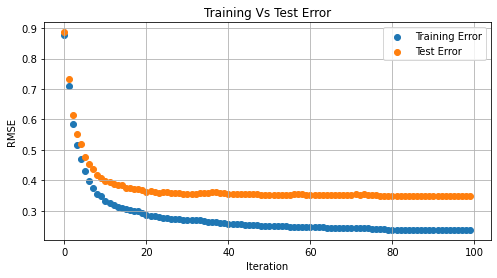

In [86]:
plt.figure(figsize=(8,4))
plt.scatter(x=training_rounds,y=eval_result['validation_0']['rmse'],label='Training Error')
plt.scatter(x=training_rounds,y=eval_result['validation_1']['rmse'],label='Test Error')
plt.grid(True)
plt.xlabel('Iteration')
plt.ylabel('RMSE')
plt.title('Training Vs Test Error')
plt.legend()
plt.show()

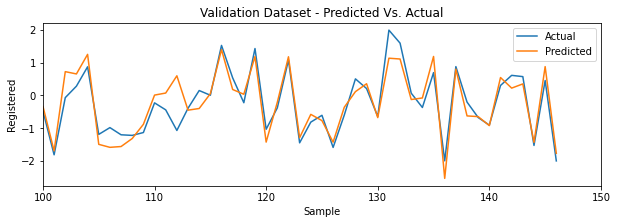

In [87]:
ypredicted = xgbmodel2.predict(X_test2)

plt.figure(figsize=(10,3))
# Actual Vs Predicted
plt.plot(y_test, label='Actual')
plt.plot(ypredicted, label='Predicted')
plt.xlabel('Sample')
plt.ylabel('Registered')
plt.xlim([100,150])
plt.title('Validation Dataset - Predicted Vs. Actual')
plt.legend()
plt.show()

In [88]:
# Over prediction and Under Prediction needs to be balanced
# Training Data Residuals
residuals = (y_test2 - ypredicted) # * y_sd2 + y_mu2 (for actual registered numbers)

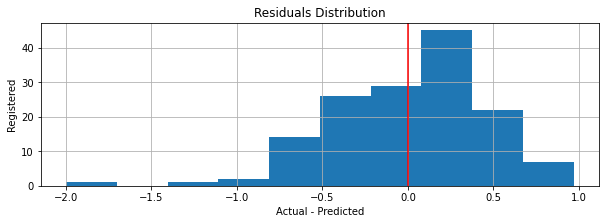

In [89]:
plt.figure(figsize=(10,3))
plt.hist(residuals)
plt.grid(True)
plt.xlabel('Actual - Predicted')
plt.ylabel('Registered')
plt.title('Residuals Distribution')
plt.axvline(color='r')
plt.show()

In [90]:
print("RMSE: {0:0.4f}".format(mean_squared_error(y_test2, ypredicted)))

RMSE: 0.2018


The RMSE score looks good. So, the model is good for the SHAP evaluation.

In [91]:
# Show the influencing features in order (with feature_importances_)
# Indicate which parameter used to decide the ranking of important features
important_features = pd.Series(data=xgbmodel2.feature_importances_, index=NAMES)
important_features.sort_values(ascending=False,inplace=True)
print(important_features)

year_2012         0.311788
clear             0.183872
winter            0.092735
atemp             0.088030
month             0.081421
year_2011         0.073831
fall              0.058006
lightsnow.rain    0.032050
hum               0.015650
temp              0.012494
windspeed         0.011184
workingday_0      0.009462
spring            0.008693
cloudy            0.007407
day               0.007382
dayofweek         0.005995
workingday_1      0.000000
holiday_1         0.000000
holiday_0         0.000000
summer            0.000000
dtype: float32


In [92]:
important_features = pd.Series(data=xgbmodel2.get_booster().get_score(importance_type='gain'), index=NAMES)
important_features.sort_values(ascending=False,inplace=True)
print(important_features)

year_2012         24.203434
clear             14.273579
winter             7.198785
atemp              6.833544
month              6.320559
year_2011          5.731370
fall               4.502886
lightsnow.rain     2.488003
hum                1.214889
temp               0.969844
windspeed          0.868157
workingday_0       0.734540
spring             0.674821
cloudy             0.574998
day                0.573031
dayofweek          0.465353
summer                  NaN
holiday_0               NaN
holiday_1               NaN
workingday_1            NaN
dtype: float64


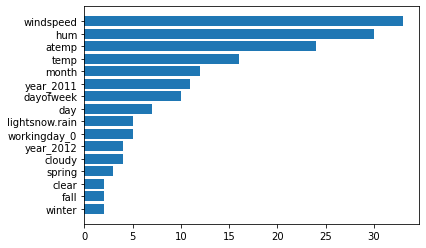

In [93]:
# Show the influencing features in order (with get_booster().get_fscore())
# fscore is based on the number of times a feature is used in a tree
fscore = xgbmodel2.get_booster().get_fscore().items()
lists = sorted(fscore, key=lambda x:x[1]) # sorted by value, return a list of tuples
fkey, fvalue = zip(*lists) # unpack a list of pairs into two tuples

plt.barh(fkey, fvalue)
plt.show()

Course [IT790A] Explainable AI

Your Name: Sandeep Sabir Palakkal Makkintepurakkal

# Question 1

A-1. Based on the model and explanation results, explain how different seasons and three
weather inputs (e.g., temperature, humidity, and windspeed) would affect the bike rental
counts positively and/or negatively (if none, state that there would be no influence)?
If you are the CEO of this bike rental company, what is your marketing strategy for selected
seasons or weather?

In [94]:
# activate javascript, load javascript library when visualization is not showing
shap.initjs()

# explain all the predictions in the test set
t0 = time.time()
explainer = shap.TreeExplainer(xgbmodel)
shap_values = explainer.shap_values(Xdf)
t1 = time.time()
print(t1-t0, " sec taken")

0.062281131744384766  sec taken


Initially, I am going to plot the summary plot.

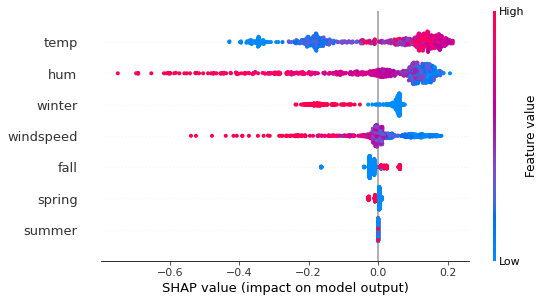

In [95]:
# Selecting the features which are needed for the plot. I am selecting all the four seasons and three weather conditions needed for the plot.
selected_features = ['winter', 'spring', 'summer', 'fall', 'temp', 'hum', 'windspeed']
selected_features_indices =  [0, 1, 2, 3, 13, 15, 16]

Xdf1 = Xdf[selected_features]

shap_values_filtered = shap_values[:, selected_features_indices]

shap.summary_plot(shap_values_filtered, Xdf1, feature_names=selected_features) #plot_type="bar" for bar type

From the summary plot we can see that, when the temperature is high people are most likely renting the bike, but when the temperature is low people are less likely renting the bike. When the humidity is low people are most likely renting the bike, but when the humididy is high people are less likely renting the bike. When the windspeed is low people are most likely renting the bike, but when the wind speed is high people are less likely renting the bike. When it is fall, people are most likely renting the bike, but when it is winter and spring people are less likely renting the bike. We can see there is no influence on summer.

Now, I am going to plot dependency plot of all three weather conditions to find their influence on the bike rental.

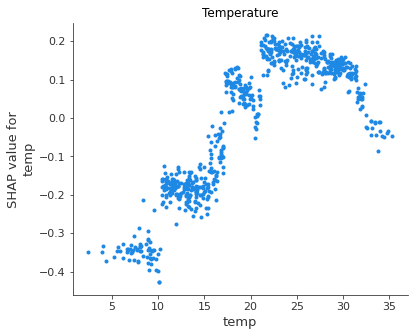

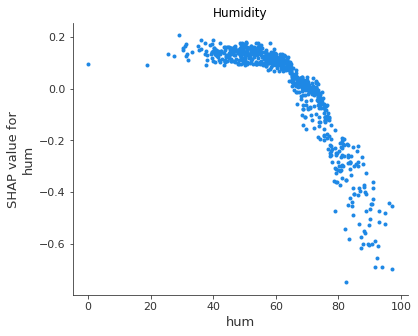

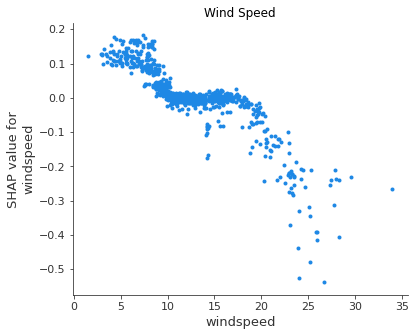

In [96]:
shap.dependence_plot("temp", shap_values, X_original, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Temperature");

shap.dependence_plot("hum", shap_values, X_original, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Humidity");

shap.dependence_plot("windspeed", shap_values, X_original, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Wind Speed");

We can see from the dependency plots, when the temperature is nearly high people are most likely renting the bike, but when the temperature is low people are less likely renting the bike. Also, when the humidity is low people are most likely renting the bike, but when the humididy is high people are less likely renting the bike. Also, when the windspeed is low people are most likely renting the bike, but when the wind speed is high people are less likely renting the bike.

We can see that in winter people are less likely renting the bike. So, if I am the CEO of the bike renting company, I will give special discounts and packages for the people who are renting bike on the winter season. I will also give special discounts and promotions, when wind speed is high and humidity is high.

# Question 2

A-2. Based on the model and explanation results, which type of days (“working days” and the “holiday/weekends”) would influence the bike rental counts positively and/or negatively (if none, state that there would be no influence)?  

If you are the CEO of this bike rental company, what is your marketing strategy for the working days and holiday/weekends (select the type of day and how to improve)?

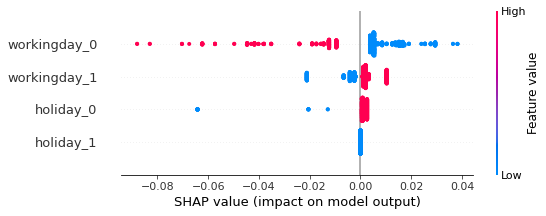

In [97]:
# Selecting the features which are needed for the plot.
selected_features = ['holiday_0', 'holiday_1', 'workingday_0', 'workingday_1']
selected_features_indices =  [4, 5, 6, 7]

Xdf2 = Xdf[selected_features]

shap_values_filtered = shap_values[:, selected_features_indices]

shap.summary_plot(shap_values_filtered, Xdf2, feature_names=selected_features) #plot_type="bar" for bar type 

From the summary plot we can see that, when it is working day people are most likely renting the bike, but when it is holiday people are less likely renting the bike.

We can see that on holidays people are less likely renting the bike. So, if I am the CEO of the bike renting company, I will give special discount and special packages for the people who are renting bike on holidays. Also, I would give additional time to use the bike, if they rent the bike on holidays.

# Question 3

A-3. Based on the model and results, explain the differences and similarities between casual and registered customers and how those differ based on the type of day (working day vs. weekend). If none, state that there would be no influence from different types of customers.

If you are the CEO of this bike rental company, what is your marketing strategy for different customers (casual vs. registered)?

In [98]:
# Get shap values for the casual customers

# activate javascript, load javascript library when visualization is not showing
shap.initjs()

# explain all the predictions in the test set
t0 = time.time()
explainer1 = shap.TreeExplainer(xgbmodel1)
shap_values1 = explainer1.shap_values(Xdf)
t1 = time.time()
print(t1-t0, " sec taken")

0.06444382667541504  sec taken


In [99]:
# Get shap values for the registered customers

# activate javascript, load javascript library when visualization is not showing
shap.initjs()

# explain all the predictions in the test set
t0 = time.time()
explainer2 = shap.TreeExplainer(xgbmodel2)
shap_values2 = explainer2.shap_values(Xdf)
t1 = time.time()
print(t1-t0, " sec taken")

0.07022523880004883  sec taken


Initially, I am going to plot summary plot for the casual and the registered customers.

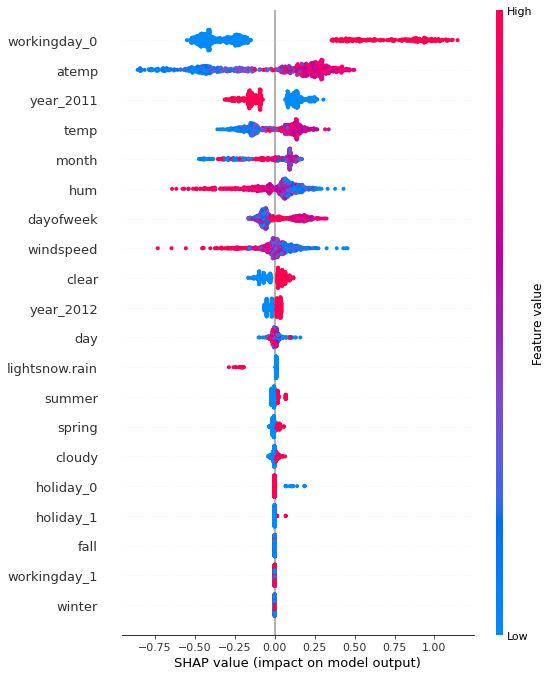

In [100]:
# Plotting the summary plot for the casual customers.
shap.summary_plot(shap_values1, Xdf, feature_names=NAMES) #plot_type="bar" for bar type

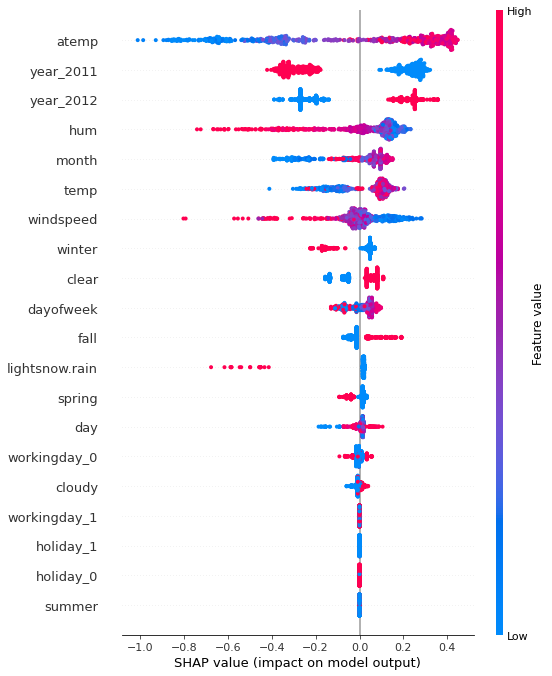

In [101]:
# Plotting the summary plot for the registered customers.
shap.summary_plot(shap_values2, Xdf, feature_names=NAMES) #plot_type="bar" for bar type

From the summary plot we can see that, both the casual and registered customers are most likely renting the bike, when the temperature is high. But, some registered customers are renting bike even the temperature is low. Similarly, both the casual and registered customers are most likely renting the bike, when the wind speed is low. But, some registered customers are renting bike even the wind speed is high. Also, both the casual and registered customers are most likely renting the bike, when the feeling temperature is high. Also, both the casual and registered customers are most likely renting the bike, when the humidity is low. Similarly, both the casual and registered customers are most likely renting the bike, when the sky is clear. Similarly, both the casual and registered customers are less likely renting the bike, when there is light snow or rain. Also, both the casual and registered customers are most likely renting the bike on the year 2012, compared to the year 2011.

If it is not working day, casual customers are more likely renting the bike. But, the registered customers are less likely renting the bike when it is not working day. But, for the working day we cannot see any influence for both the casual and registered customers. 

Since the influence of weekends on both the casual and registered customers are not clear in the summary plot, I am plotting the dependency plot.

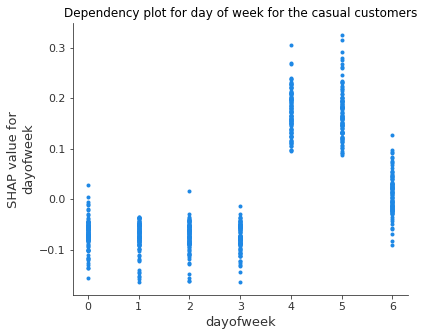

In [102]:
shap.dependence_plot("dayofweek", shap_values1, X_original, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Dependency plot for day of week for the casual customers");

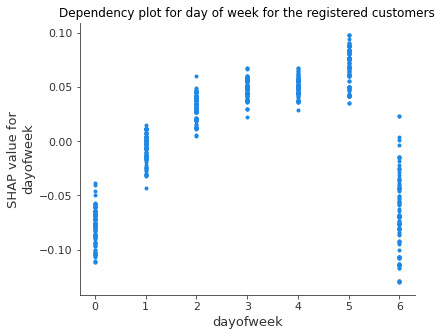

In [103]:
shap.dependence_plot("dayofweek", shap_values2, X_original, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Dependency plot for day of week for the registered customers");

From the dependency plot, we can see that both the casual and registered customers are more likely renting the bike on
Saturdays. On Sundays we cannot see any influence for the casual customers, but the registered customers are less likely renting the bike on Sundays.

So, if I am the CEO of the bike renting company, I will give special packages for the casual customers for them to become registered customers because registered customers are more likely renting the bike even the weather is bad than the casual customers. For the registered customers, I will give special discounts when the weather is bad like low temperature, high humidity and high wind speed where they are less likely renting the bikes. Also for the casual and registered customers, I will give weekend discount for them to rent the bike on weekends.

# Question 4

A-4. Based on the model and explanation results, explore the different seasons and atmospheric weather variables (e.g., temperature, feeling temperature, humidity, wind speed) in 2011 and 2012 that might affect the bike rental counts positively and/or negatively (if none, state that there would be no influence)?

What is your marketing strategy for the upcoming years or months if you are the CEO of this bike rental company?



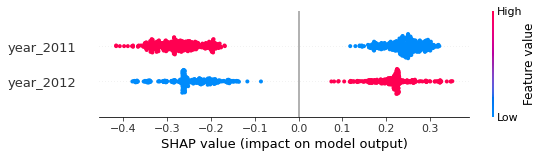

In [104]:
# Initially, I am going to check the influence of the years 2011 and 2012 by plotting the summary plot.
selected_features = ['year_2011', 'year_2012']
selected_features_indices =  [11, 12]

Xdf4 = Xdf[selected_features]

shap_values_filtered = shap_values[:, selected_features_indices]

shap.summary_plot(shap_values_filtered, Xdf4, feature_names=selected_features) #plot_type="bar" for bar type

From the summary plot, we can see that the people are most likely rent the bike on the year 2012 than the year 2011. Now, I am going to explore all the seasons and the weather conditions on both years to find the influence of renting the bike. For this, I am going to split 2011 and 2012 years data initially.

In [105]:
Xdf_2011 = Xdf[Xdf['year_2011'] == 1]
Xdf_2012 = Xdf[Xdf['year_2012'] == 1]
X_original_2011 = X_original[X_original['year_2011'] == 1]
X_original_2012 = X_original[X_original['year_2012'] == 1]

Now, I am going to plot the summary plot for the years 2011 and 2012.

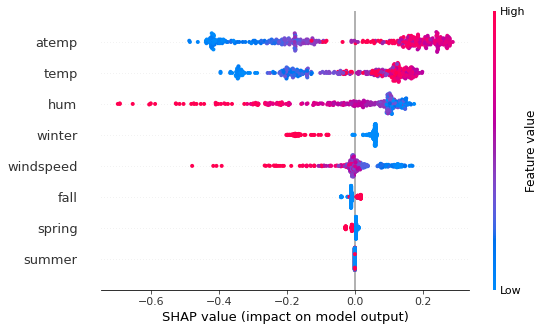

In [106]:
# Summary plot for the year 2011
# Selecting the features which are needed for the plot. I am selecting all the four seasons and four weather conditions needed for the plot.
selected_features = ['winter', 'spring', 'summer', 'fall', 'temp', 'atemp', 'hum', 'windspeed']
selected_features_indices =  [0, 1, 2, 3, 13, 14, 15, 16]

Xdf_2011 = Xdf_2011[selected_features]

# Get the row indices of the data of the year 2011
row_indices_2011 = Xdf.index[Xdf['year_2011'] == 1].tolist()

shap_values_filtered_2011 = shap_values[row_indices_2011, :]
shap_values_filtered = shap_values_filtered_2011[:, selected_features_indices]

shap.summary_plot(shap_values_filtered, Xdf_2011, feature_names=selected_features) #plot_type="bar" for bar type

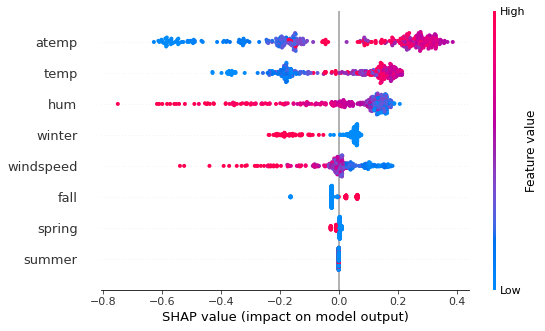

In [107]:
# Summary plot for the year 2012
# Selecting the features which are needed for the plot. I am selecting all the four seasons and four weather conditions needed for the plot.
selected_features = ['winter', 'spring', 'summer', 'fall', 'temp', 'atemp', 'hum', 'windspeed']
selected_features_indices =  [0, 1, 2, 3, 13, 14, 15, 16]

Xdf_2012 = Xdf_2012[selected_features]

# Get the row indices of the data of the year 2012
row_indices_2012 = Xdf.index[Xdf['year_2012'] == 1].tolist()

shap_values_filtered_2012 = shap_values[row_indices_2012, :]
shap_values_filtered = shap_values_filtered_2012[:, selected_features_indices]

shap.summary_plot(shap_values_filtered, Xdf_2012, feature_names=selected_features) #plot_type="bar" for bar type

Now, I am going to plot the dependency plot for all the four seasons and four weather conditions for both the years of 2011 and 2012.

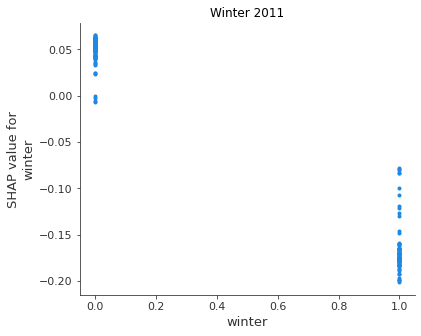

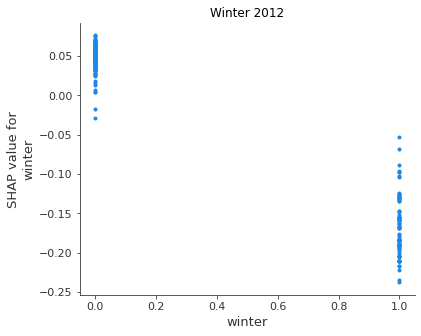

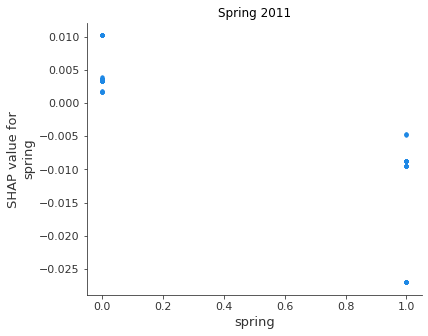

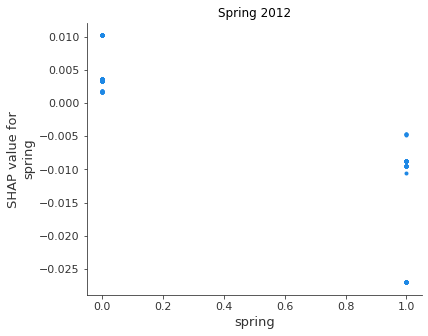

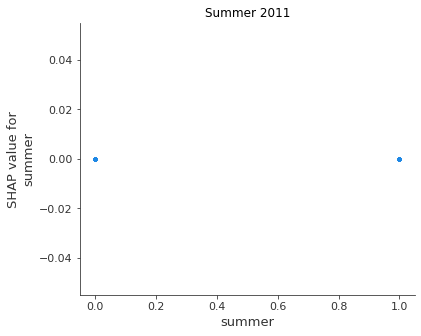

...

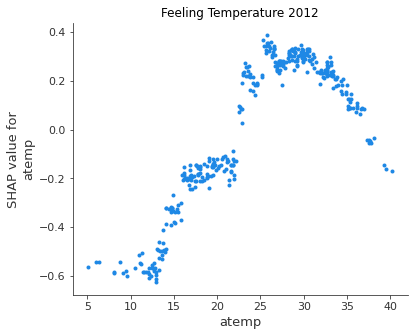

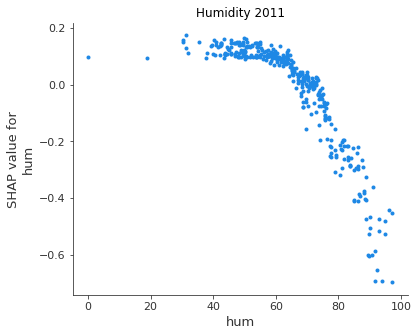

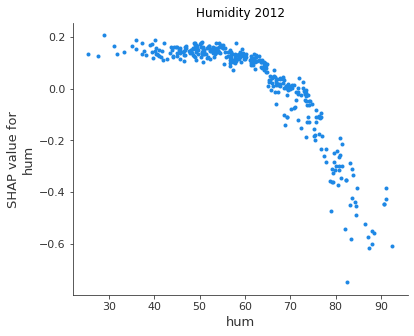

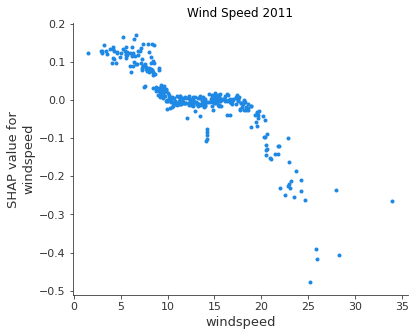

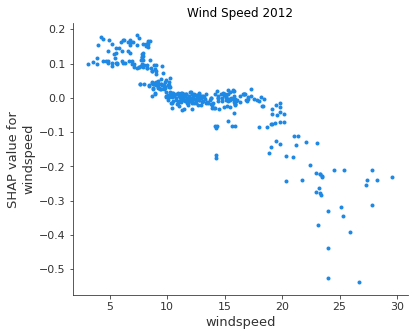

In [108]:
shap.dependence_plot("winter", shap_values_filtered_2011, X_original_2011, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Winter 2011");

shap.dependence_plot("winter", shap_values_filtered_2012, X_original_2012, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Winter 2012");

shap.dependence_plot("spring", shap_values_filtered_2011, X_original_2011, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Spring 2011");

shap.dependence_plot("spring", shap_values_filtered_2012, X_original_2012, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Spring 2012");

shap.dependence_plot("summer", shap_values_filtered_2011, X_original_2011, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Summer 2011");

shap.dependence_plot("summer", shap_values_filtered_2012, X_original_2012, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Summer 2012");

shap.dependence_plot("fall", shap_values_filtered_2011, X_original_2011, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Fall 2011");

shap.dependence_plot("fall", shap_values_filtered_2012, X_original_2012, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Fall 2012");

shap.dependence_plot("temp", shap_values_filtered_2011, X_original_2011, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Temperature 2011");

shap.dependence_plot("temp", shap_values_filtered_2012, X_original_2012, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Temperature 2012");

shap.dependence_plot("atemp", shap_values_filtered_2011, X_original_2011, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Feeling Temperature 2011");

shap.dependence_plot("atemp", shap_values_filtered_2012, X_original_2012, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Feeling Temperature 2012");

shap.dependence_plot("hum", shap_values_filtered_2011, X_original_2011, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Humidity 2011");

shap.dependence_plot("hum", shap_values_filtered_2012, X_original_2012, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Humidity 2012");

shap.dependence_plot("windspeed", shap_values_filtered_2011, X_original_2011, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Wind Speed 2011");

shap.dependence_plot("windspeed", shap_values_filtered_2012, X_original_2012, feature_names=NAMES, show=False, interaction_index=None)
plt.title("Wind Speed 2012");

From the summary plot, we can see that in both the years of 2011 and 2012, people are most likely renting the bike, when the temperature and the feeling temperature is high. But, people are less likely renting the bike, when the temperature and the feeling temperature is low. Also, in both the years of 2011 and 2012, people are most likely renting the bike, when the humidity is low. But, people are less likely renting the bike, when the humidity is high. Also, in both the years of 2011 and 2012, people are most likely renting the bike, when the wind speed is low. But, people are less likely renting the bike, when the wind speed is high. Also, in both the years of 2011 and 2012, people are most likely renting the bike, when it is fall. But, people are less likely renting the bike, when it is winter. We can see there is no influence on spring and summer on both the years.

From the summary and dependency plots, we can see both the years of 2011 and 2012, had similar impact for the people renting the bike. That means, eventhough more people renting the bike most likely on 2012 compared to 2011, there is no change in the renting behaviour related to weather conditions and seasons.

We can see that in winter, people are less likely renting the bike for both the years of 2011 and 2012. So, if I am the CEO of the bike renting company, I will give special discounts and packages for the people who are renting bike on the winter season. I will also give special discounts and promotions, when wind speed is high and humidity is high.

# Question 5

A-5. List the top 5 pairs of features that show high interactions and explain the interactions (SHAP interaction plot).



For this, I am going to plot heatmap to find the pairs of features which shows high interactions.

In [109]:
shap_interaction_values = explainer.shap_interaction_values(Xdf)

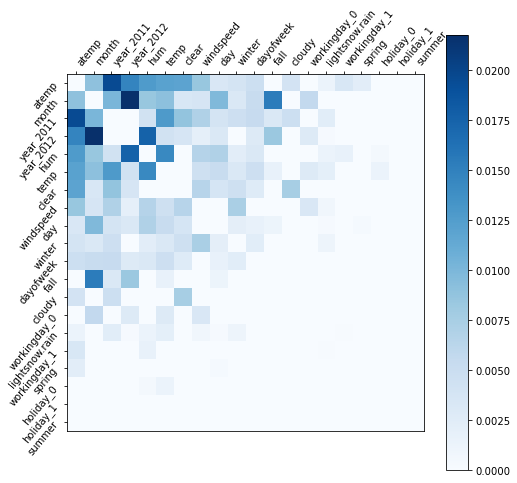

In [110]:
tmp = np.abs(shap_interaction_values).mean(0)
for i in range(tmp.shape[0]):
    tmp[i,i] = 0
inds = np.argsort(-tmp.sum(0))[:50]
tmp2 = tmp[inds,:][:,inds]
plt.figure(figsize=(8,8))
plt.imshow(tmp2, cmap=plt.get_cmap("Blues"))
plt.colorbar()
plt.yticks(range(tmp2.shape[0]), Xdf.columns.values[inds], rotation=50.4, horizontalalignment="right")
plt.xticks(range(tmp2.shape[0]), Xdf.columns.values[inds], rotation=50.4, horizontalalignment="left")
plt.gca().xaxis.tick_top()
plt.show()

From the heatmap, the top 5 pairs of features that show high interactions are given below.

 1) year_2012 and month.
 2) year_2011 and atemp.
 3) year_2012 and hum.
 4) fall and month.
 5) temp and hum.
 
 Now, I am going to plot SHAP interaction plots for all these pairs of features.

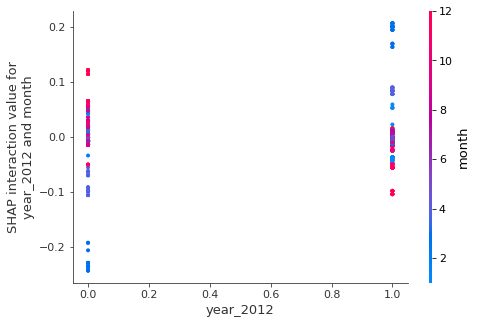

In [111]:
shap.dependence_plot(
    ("year_2012", "month"),
    shap_interaction_values, X_original)

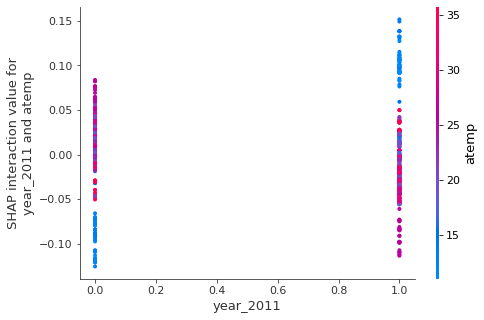

In [112]:
shap.dependence_plot(
    ("year_2011", "atemp"),
    shap_interaction_values, X_original)

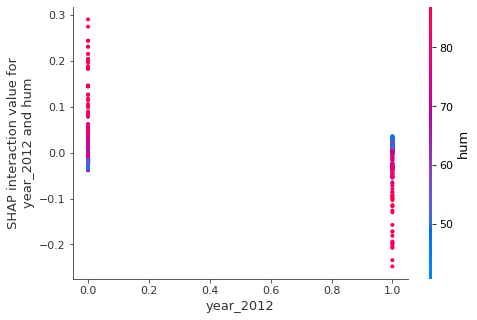

In [113]:
shap.dependence_plot(
    ("year_2012", "hum"),
    shap_interaction_values, X_original)

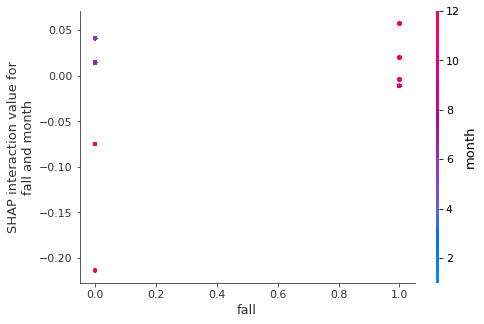

In [114]:
shap.dependence_plot(
    ("fall", "month"),
    shap_interaction_values, X_original)

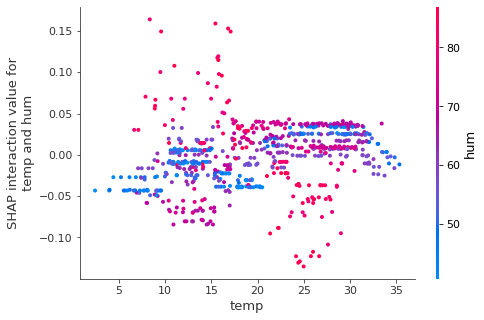

In [115]:
shap.dependence_plot(
    ("temp", "hum"),
    shap_interaction_values, X_original)

From the interaction plots above, it is difficult to interpret from the first two plots. From the third plot with year_2012 and hum, we can see that for the year 2012 when the humidity is low, people are most likely renting the bike. From the fourth plot, we cannot make any statement, since only 4 datapoints in the plot. From the fifth plot with temp and hum, we can see that when the temperature is medium and humidity is low, people are most likely renting the bike. Also from the plot, we can see some people are renting the bike even the humidity is high.

# Question 6

Based on the model and explanation results, explain how different seasons and clear sky would affect the bike rental counts positively and/or negatively?

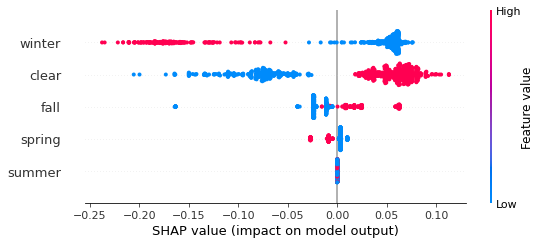

In [116]:
# Selecting the features which are needed for the plot. I am selecting all the four seasons and three weather conditions needed for the plot.
selected_features = ['winter', 'spring', 'summer', 'fall', 'clear']
selected_features_indices =  [0, 1, 2, 3, 8]

Xdf3 = Xdf[selected_features]

shap_values_filtered = shap_values[:, selected_features_indices]

shap.summary_plot(shap_values_filtered, Xdf3, feature_names=selected_features) #plot_type="bar" for bar type

From the summary plot we can see that, when it is clear sky, people are most likely renting the bike. Also, When it is fall, people are most likely renting the bike, but when it is winter and spring people are less likely renting the bike. We can see there is no influence on summer.

Now, I am going to plot the interaction plot of clear with all other seasons.

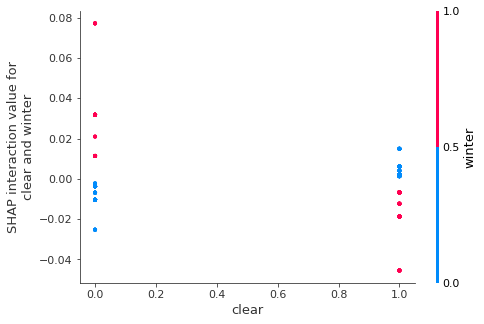

In [117]:
shap.dependence_plot(
    ("clear", "winter"),
    shap_interaction_values, X_original)

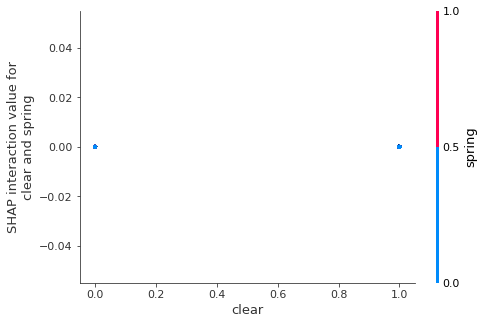

In [118]:
shap.dependence_plot(
    ("clear", "spring"),
    shap_interaction_values, X_original)

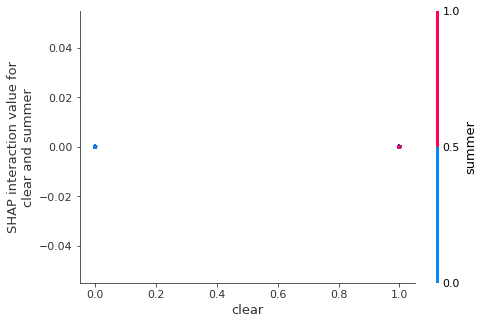

In [119]:
shap.dependence_plot(
    ("clear", "summer"),
    shap_interaction_values, X_original)

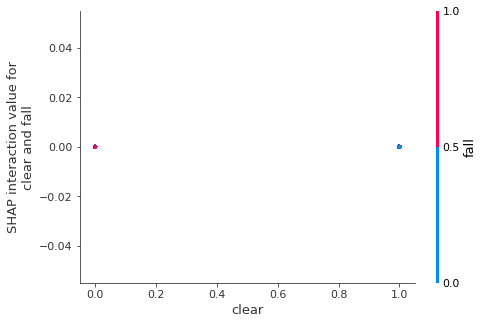

In [120]:
shap.dependence_plot(
    ("clear", "fall"),
    shap_interaction_values, X_original)

We can see that for the winter season, even when the sky is clear people are less likely renting the bike. But, we can't find the influence of other seasons on clear sky due to less data we have.

# Section B

# Question 1

B-1. From the LIME tutorial, the ‘atemp (feeling temperature)’ and ‘humidity’ relationship (four categories) affect each day of the total counts of renting a bike. Change the target to explain the same (day) instance of a renting behavior for the ‘casual’ users and ‘registered’ users. The four instances are categorized as ‘atemp low/humidity higher’, ‘atemp low/humidity lower’, ‘atemp high/humidity lower’, and ‘atemp high/humidity average’. Show the four LIME visualizations for ‘casual’ users and ‘registered’ users, respectively.

Initially, I am going to get the distribution of 'atemp' and 'humidity' to get the low and high values for the feeling temperature and humidity.

In [121]:
# normalized vs original: distribution of humidity, normalized value and ignore scientific format
df_hat_n = pd.DataFrame(Xdf['hum'].describe().apply(lambda x: format(x, 'f')))
df_hat_n['atemp'] = Xdf['atemp'].describe().apply(lambda x: format(x, 'f'))
df_hat_n['temp'] = Xdf['temp'].describe().apply(lambda x: format(x, 'f'))
df_hat_n['month'] = Xdf['month'].describe().apply(lambda x: format(x, 'f'))
df_hat_n['day'] = Xdf['day'].describe().apply(lambda x: format(x, 'f'))
df_hat_n['dayofweek'] = Xdf['dayofweek'].describe().apply(lambda x: format(x, 'f'))
df_hat_n['windspeed'] = Xdf['windspeed'].describe().apply(lambda x: format(x, 'f'))

df_hat = pd.DataFrame((df['hum']*100).describe())
df_hat['atemp'] = ((df['atemp']*50).describe())
df_hat['temp'] = ((df['temp']*41).describe())
df_hat['month'] = ((df['month']).describe())
df_hat['day'] = ((df['day']).describe())
df_hat['dayofweek'] = ((df['dayofweek']).describe())
df_hat['windspeed'] = ((df['windspeed']*67).describe())

display(df_hat)
display(df_hat_n)

,hum,atemp,temp,month,day,dayofweek,windspeed
count,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000
mean,62.789406,23.717699,20.310776,6.519836,15.738714,3.002736,12.762576
std,14.242910,8.148059,7.505091,3.451913,8.809949,2.004787,5.192357
min,0.000000,3.953480,2.424346,1.000000,1.000000,0.000000,1.500244
25%,52.000000,16.892125,13.820424,4.000000,8.000000,1.000000,9.041650
50%,62.666700,24.336650,20.431653,7.000000,16.000000,3.000000,12.125325
75%,73.020850,30.430100,26.872076,10.000000,23.000000,5.000000,15.625371
max,97.250000,42.044800,35.328347,12.000000,31.000000,6.000000,34.000021


,hum,atemp,temp,month,day,dayofweek,windspeed
count,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000
mean,-0.000000,0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000
std,1.000685,1.000685,1.000685,1.000685,1.000685,1.000685,1.000685
min,-4.411486,-2.427296,-2.384871,-1.600161,-1.674108,-1.498809,-2.170506
25%,-0.758047,-0.838267,-0.865385,-0.730482,-0.879008,-0.999661,-0.717107
50%,-0.008621,0.076015,0.016117,0.139196,0.029678,-0.001366,-0.122813
75%,0.718845,0.824368,0.874845,1.008875,0.824779,0.996930,0.551725
max,2.421148,2.250800,2.002355,1.588660,1.733465,1.496077,4.092936


Initially, I am going to study the behaviour of the casual customer on low feeling temperature and higher humidity.

In [122]:
# Select from the test set
# Get the instance of low atemp and higher humidity
test = X_test1[(X_test1['atemp'] < -1) & (X_test1['hum'] > 1)]
test

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
35,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-1.432558,-1.420304,2.116697,-0.379718,-1.310268,-1.219765,0.99693
301,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,-1.318665,-1.513304,1.788822,2.077411,1.008875,1.506293,0.99693


In [123]:
PICK = 301
Xdf_lahh = Xdf[Xdf.index==PICK]
Xdf_lahh_original = X_original[X_original.index==PICK]
Xdf_lahh

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
301,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,-1.318665,-1.513304,1.788822,2.077411,1.008875,1.506293,0.99693


In [124]:
# Get the total bike rental count for casual customers on this instance
print("target count is:", y1[PICK])

target count is: 57


We can see there are only 57 rental count on this instance, which is very low compared to mean of casual customers, which was 848. So, the plot should show a negative rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [125]:
# let the LIME Explainer know which features are categorical
categorical_features = [0,1,2,3,4,5,6,7,8,9,10,11,12]

In [126]:
categorical_names = {}
for feature in categorical_features:    
    le = LabelEncoder()
    le.fit(Xdf.iloc[:, feature])
    categorical_names[feature] = le.classes_

In [127]:
# Initialize the explainer
# Note that this is a regression problem, not a classification
explainer1 = LimeTabularExplainer(X_train1.values, feature_names=NAMES,
                                  categorical_features=categorical_features, 
                                  categorical_names=categorical_names,
                                  verbose=True, mode='regression')

explainer2 = LimeTabularExplainer(X_train2.values, feature_names=NAMES,
                                  categorical_features=categorical_features, 
                                  categorical_names=categorical_names,
                                  verbose=True, mode='regression')

In [128]:
# Explain one day of low atemp and higher humidity for the casual customer. Target count: 57
print("Lime plot of casual customers on a low atemp and higher humidity day")
#Explanation object has information about features contributions to this particular prediction
exp_casual_lahh = explainer1.explain_instance(Xdf_lahh.values[0], xgbmodel1.predict)#, num_features=10)
exp_casual_lahh.show_in_notebook(show_all=False)

Lime plot of casual customers on a low atemp and higher humidity day
Intercept 0.34180142447995215
Prediction_local [-0.62668247]
Right: -1.1842549


Based on the local model, the prediction value showed -0.627 while the actual model predicted -1.184, which is aligned and shows a negative rent prediction on this day.

The renting prediction is negatively affected mostly by low feeling temperature. It also affected negatively by high humidity, year 2011, low temperature, light snow or rain, high wind speed, not clear sky and not holiday.

Not working day, and day of week in the middle of the week raise the rent prediction, but not enough to push the scales toward positive.

Now, I am going to study the behaviour of registered customers on the same instance.

In [129]:
# Get the total bike rental count for registered customers on this instance
print("target count is:", y2[PICK])

target count is: 570


We can see there are only 570 rental count on this instance, which is very low compared to mean of registered customers, which was 3656. So, the plot should show a negative rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [130]:
# Explain one day of low atemp and higher humidity for the registered customer. Target count: 570
print("Lime plot of registered customers on a low atemp and higher humidity day")
#Explanation object has information about features contributions to this particular prediction
exp_registered_lahh = explainer2.explain_instance(Xdf_lahh.values[0], xgbmodel2.predict)#, num_features=10)
exp_registered_lahh.show_in_notebook(show_all=False)

Lime plot of registered customers on a low atemp and higher humidity day
Intercept 0.7706703398868965
Prediction_local [-2.38727561]
Right: -2.5373755


Based on the local model, the prediction value showed -2.387 while the actual model predicted -2.537, which is aligned and shows a negative rent prediction on this day.

The renting prediction is negatively affected mostly by low feeling temperature. It also affected negatively by year 2011, light snow or rain, high humidity, low temperature, high wind speed and not clear sky.

Not winter, and fall raise the rent prediction, but not enough to push the scales toward positive.

Now, I am going to study the behaviour of the casual customer on low feeling temperature and low humidity.

In [131]:
# Select from the test set
# Get the instance of low atemp and low humidity
test = X_test1[(X_test1['atemp'] < -1) & (X_test1['hum'] < -1)]
test

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
8,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,-1.951895,-2.199446,-1.361096,2.214012,-1.600161,-0.765422,1.496077
368,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,-2.120449,-2.180029,-1.498690,-0.074714,-1.600161,-1.333351,-0.500513
434,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,-1.136444,-1.207168,-1.949511,0.455341,-1.020375,-0.651836,0.996930
421,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,-1.181998,-1.265253,-1.530890,0.190365,-1.310268,1.165536,1.496077
721,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,-1.254891,-1.462950,-1.311332,2.800184,1.588660,0.711193,0.996930
314,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,-0.935996,-1.028783,-1.276203,1.603577,1.298767,-0.538250,0.497782
693,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,-1.186557,-1.385400,-1.568949,2.406678,1.298767,0.938364,0.996930
50,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,-1.148924,-1.209852,-1.546164,0.422866,-1.310268,0.484021,1.496077
61,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.623893,-1.683890,-2.174928,0.455392,-1.020375,-1.446936,-0.001366
382,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,-1.049889,-1.222600,-1.296697,2.904555,-1.600161,0.256850,-0.500513


In [132]:
PICK = 368
Xdf_lalh = Xdf[Xdf.index==PICK]
Xdf_lalh_original = X_original[X_original.index==PICK]
Xdf_lalh

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
368,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,-2.120449,-2.180029,-1.49869,-0.074714,-1.600161,-1.333351,-0.500513


In [133]:
# Get the total bike rental count for casual customers on this instance
print("target count is:", y1[PICK])

target count is: 95


We can see there are only 95 rental count on this instance, which is very low compared to mean of casual customers, which was 848. So, the plot should show a negative rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [134]:
# Explain one day of low atemp and low humidity for the casual customer. Target count: 2273
print("Lime plot of casual customers on a low atemp and low humidity day")
#Explanation object has information about features contributions to this particular prediction
exp_casual_lalh = explainer1.explain_instance(Xdf_lalh.values[0], xgbmodel1.predict)#, num_features=10)
exp_casual_lalh.show_in_notebook(show_all=False)

Lime plot of casual customers on a low atemp and low humidity day
Intercept 0.8864561797707906
Prediction_local [-0.85431685]
Right: -1.0735286


Based on the local model, the prediction value showed -0.854 while the actual model predicted -1.074, which is aligned and shows a negative rent prediction on this day.

The renting prediction is negatively affected mostly by working day. It also affected negatively by low feeling temperature, low temperature, not holiday, not clear sky, day of week in the middle of the week and the month which is near to the start of the year.

Year 2012, less humidity and no light snow or rain raise the rent prediction, but not enough to push the scales toward positive.

Now, I am going to study the behaviour of registered customers on the same instance.

In [135]:
# Get the total bike rental count for registered customers on this instance
print("target count is:", y2[PICK])

target count is: 2273


We can see there are 2273 rental count on this instance, which is low compared to mean of registered customers, which was 3656. So, the plot should show a negative rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [136]:
# Explain one day of low atemp and low humidity for the registered customer. Target count: 2273
print("Lime plot of registered customers on a low atemp and low humidity day")
#Explanation object has information about features contributions to this particular prediction
exp_registered_lalh = explainer2.explain_instance(Xdf_lalh.values[0], xgbmodel2.predict)#, num_features=10)
exp_registered_lalh.show_in_notebook(show_all=False)

Lime plot of registered customers on a low atemp and low humidity day
Intercept -0.6960068254632985
Prediction_local [-0.61688313]
Right: -0.9461498


Based on the local model, the prediction value showed -0.617 while the actual model predicted -0.946, which is aligned and shows a negative rent prediction on this day.

The renting prediction is negatively affected mostly by low feeling temperature. It also affected negatively by low temperature, the month near to the start of the year, winter, not clear sky and not fall.

No light snow or rain, year 2012 and low humidity raise the rent prediction, but not enough to push the scales toward positive.

Now, I am going to study the behaviour of the casual customer on high feeling temperature and low humidity.

In [137]:
# Select from the test set
# Get the instance of low atemp and higher humidity
test = X_test1[(X_test1['atemp'] > 1) & (X_test1['hum'] < -1)]
test

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
543,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.104903,1.022035,-1.882182,1.049635,-0.150697,1.279122,-0.500513
233,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.073016,1.006450,-1.109339,1.113874,0.429089,0.711193,-1.498809
551,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.815574,1.762441,-1.194232,0.045746,0.139196,-1.219765,-0.001366
175,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.091236,1.037515,-1.015664,0.246431,-0.150697,1.051950,0.996930
207,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.528572,1.328299,-1.580654,-0.090687,0.139196,1.279122,-0.500513
540,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.355458,1.227512,-1.044933,-0.580558,-0.150697,0.938364,1.496077
223,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.164124,1.103398,-1.495761,-0.837567,0.429089,-0.424665,0.497782


In [138]:
PICK = 551
Xdf_halh = Xdf[Xdf.index==PICK]
Xdf_halh_original = X_original[X_original.index==PICK]
Xdf_halh

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
551,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.815574,1.762441,-1.194232,0.045746,0.139196,-1.219765,-0.001366


In [139]:
# Get the total bike rental count for casual customers on this instance
print("target count is:", y1[PICK])

target count is: 1405


We can see there are 1405 rental count on this instance, which is high compared to mean of casual customers, which was 848. So, the plot should show a positive rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [140]:
# Explain one day of high atemp and low humidity for the casual customer. Target count: 1405
print("Lime plot of casual customers on a high atemp and low humidity day")
#Explanation object has information about features contributions to this particular prediction
exp_casual_halh = explainer1.explain_instance(Xdf_halh.values[0], xgbmodel1.predict)#, num_features=10)
exp_casual_halh.show_in_notebook(show_all=False)

Lime plot of casual customers on a high atemp and low humidity day
Intercept 0.33802279387703027
Prediction_local [0.40770394]
Right: 0.15300013


Based on the local model, the prediction value showed 0.390 while the actual model predicted is 0.153, which is aligned and shows a positive rent prediction on this day.

The renting prediction is positive affected mostly by high feeling temperature. It also affected positive by year 2012, no light snow or rain, low humidity, high temperature, clear sky, month which is middle of the year, and not holiday.

Working day and day of week in the middle of the week reduce the rent prediction, but not enough to push the scales toward negative.

Now, I am going to study the behaviour of registered customers on the same instance.

In [141]:
# Get the total bike rental count for registered customers on this instance
print("target count is:", y2[PICK])

target count is: 4836


We can see there are 4836 rental count on this instance, which is little high compared to mean of registered customers, which was 3656. So, the plot should show a positive rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [142]:
# Explain one day of high atemp and low humidity for the registered customer. Target count: 4836
print("Lime plot of registered customers on a high atemp and low humidity day")
#Explanation object has information about features contributions to this particular prediction
exp_registered_halh = explainer2.explain_instance(Xdf_halh.values[0], xgbmodel2.predict)#, num_features=10)
exp_registered_halh.show_in_notebook(show_all=False)

Lime plot of registered customers on a high atemp and low humidity day
Intercept -1.5278154740949714
Prediction_local [1.20042255]
Right: 0.76378304


Based on the local model, the prediction value showed 1.228 while the actual model predicted is 0.764, which is aligned and shows a positive rent prediction on this day.

The renting prediction is positive affected mostly by no light snow or rain. It also affected positive by year 2012, high feeling temperature, low humidity, clear sky, not winter, high temperature and month which is middle of the year.

Not holiday only reduce the rent prediction, but not enough to push the scales toward negative.

Now, I am going to study the behaviour of the casual customer on high feeling temperature and average humidity.

In [143]:
# Select from the test set
# Get the instance of low atemp and higher humidity
test = X_test1[(X_test1['atemp'] > 1) & (X_test1['hum'] >= -1) & (X_test1['hum'] <= 1)]
test

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
159,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.710794,1.739181,-0.418467,-0.524286,-0.150697,-0.765422,-0.001366
512,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.063903,1.025922,0.486111,0.318740,-0.440589,1.279122,1.496077
161,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.255237,1.250749,0.187512,-0.460150,-0.150697,-0.538250,0.996930
581,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.628793,1.700421,-0.102304,0.864768,0.429089,-1.333351,0.996930
565,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.501239,1.475520,-0.193050,-0.323549,0.139196,0.370436,-0.001366
553,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,2.002355,2.029841,-0.954187,-0.347760,0.139196,-0.992593,0.996930
216,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.177791,1.118903,0.020649,-0.074766,0.429089,-1.219765,0.497782
187,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.391905,1.304989,0.164095,-0.403981,0.139196,-0.992593,-0.001366
579,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.405571,1.429134,0.222642,-0.789365,0.429089,-1.560522,-0.001366
535,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.054790,1.107389,0.436347,-0.548380,-0.150697,0.370436,-0.999661


In [144]:
PICK = 584
Xdf_haah = Xdf[Xdf.index==PICK]
Xdf_haah_original = X_original[X_original.index==PICK]
Xdf_haah

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
584,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.314458,1.371001,0.532952,-0.950072,0.429089,-0.992593,-0.999661


In [145]:
# Get the total bike rental count for casual customers on this instance
print("target count is:", y1[PICK])

target count is: 1278


We can see there are 1278 rental count on this instance, which is little high compared to mean of casual customers, which was 848. So, the plot should show a positive rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [146]:
# Explain one day of high atemp and average humidity for the casual customer. Target count: 5995
print("Lime plot of casual customers on a high atemp and average humidity day")
#Explanation object has information about features contributions to this particular prediction
exp_casual_haah = explainer1.explain_instance(Xdf_haah.values[0], xgbmodel1.predict)#, num_features=10)
exp_casual_haah.show_in_notebook(show_all=False)

Lime plot of casual customers on a high atemp and average humidity day
Intercept 0.3066394506964987
Prediction_local [0.31160767]
Right: 0.33211437


Based on the local model, the prediction value showed 0.286 while the actual model predicted is 0.332, which is aligned and shows a positive rent prediction on this day.

The renting prediction is positive affected mostly by high feeling temperature. It also affected positive by year 2012, no light snow or rain, less wind speed, high temperature and month which is middle of the year.

Working day, not holiday, day of week in the beginning of the week and not clear sky reduce the rent prediction, but it is not enough to push the scales toward negative.

Now, I am going to study the behaviour of registered customers on the same instance.

In [147]:
# Get the total bike rental count for registered customers on this instance
print("target count is:", y2[PICK])

target count is: 5995


We can see there are 5995 rental count on this instance, which is very high compared to mean of registered customers, which was 3656. So, the plot should show a positive rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [148]:
# Explain one day of high atemp and average humidity for the registered customer. Target count: 5995
print("Lime plot of registered customers on a high atemp and average humidity day")
#Explanation object has information about features contributions to this particular prediction
exp_registered_haah = explainer2.explain_instance(Xdf_haah.values[0], xgbmodel2.predict)#, num_features=10)
exp_registered_haah.show_in_notebook(show_all=False)

Lime plot of registered customers on a high atemp and average humidity day
Intercept -1.4988048265170208
Prediction_local [1.00369114]
Right: 1.186183


Based on the local model, the prediction value showed 1.014 while the actual model predicted is 1.186, which is aligned and shows a positive rent prediction on this day.

The renting prediction is positive affected mostly by no light snow or rain. It also affected positive by year 2012, high feeling temperature, not winter, less wind speed, month which is middle of the year and high temperature.

Not clear sky, and day of week in the beginning of the week reduce the rent prediction, but it is so negligible enough to push the scales toward negative.

# Question 2

B-2. Based on ‘B-1’, compare the results of ‘casual’ users and ‘registered’ users and describe the similarities and differences.

Based on the single instance LIME explanation in this example and your comparison analysis, if you are the CEO of this bike rental company, what is your marketing strategy based on the findings?

# Explanation

# Low feeling temperature and high humidity day

On a day with low feeling temperature and high humidity, low feeling temperature, high humidity, year 2011,
low temperature, light snow or rain, high wind speed, not clear sky are the features that affects negative rent prediction for both casual and registered customers.

For casual customers, not holiday affects the rent negatively, but for registered customers it has no effect. For casual customers, not working day and day of week in the middle of the week affects the rent positively. But, for registered customers, not winter and fall affects the rent positively.

# Low feeling temperature and low humidity day

On a day with low feeling temperature and low humidity, low feeling temperature, low temperature, not clear sky and month near the start of the year are the features that affects negative rent prediction for both casual and registered customers. Year 2012, no light snow or rain and less humidity are the features that affects positive rent prediction for both casual and registered customers.

For casual customers, not holiday and day of week in the middle of the week affects the rent negatively. But for registered customers, winter and not fall affects the rent negatively.

# High feeling temperature and low humidity day

On a day with high feeling temperature and low humidity, high feeling temperature, less humidity, year 2012,
high temperature, no light snow or rain, month near the middle of the year and clear sky are the features that affects positive rent prediction for both casual and registered customers.

For registered customers, not winter affects the rent positively, but for casual customers it has no effect. For casual customers, working day, day of week in the middle of the week, and not holiday affects the rent negatively. But, for registered customers, not fall affects the rent negatively.

# High feeling temperature and average humidity day

On a day with high feeling temperature and average humidity, high feeling temperature, year 2012,
high temperature, no light snow or rain, month near the middle of the year and low wind speed are the features that affects positive rent prediction for both casual and registered customers. Not clear sky affects negative rent prediction for both casual and registered customers

For registered customers, not winter and not spring affects the rent positively, but for casual customers it has no effect. For casual customers, working day and day of week near the start of the week affects the rent negatively. But, for registered customers, it has no effect.

# Marketing strategy

From the plots we can see when there is high temperature, high wind speed, high humidity, there is snow or rain, not clear sky and winter season people are less likely renting the bike for both casual and registered customers. So, as the CEO of the company, I will give special discount for both casual and registered customers in these conditions.

Also, from the plot we can see for casual customers, when it is not holiday, day of week in the start and middle of the week, working day affects the rental behaviour negatively. But, for registered customers these conditions does n't have any negative effect. So, as a CEO of the company, I will give special monthly package with discount to casual customers for them to become registered customers.

# Question 3

B-3. Based on ‘B-1’, use SHAP for local explanations and describe the similarities and differences.

In [149]:
# activate javascript, load javascript library when visualization is not showing
shap.initjs()

# explain all the predictions in the test set
t0 = time.time()
explainer1_shap = shap.TreeExplainer(xgbmodel1)
t1 = time.time()
print(t1-t0, " sec taken")

0.06671476364135742  sec taken


In [150]:
# activate javascript, load javascript library when visualization is not showing
shap.initjs()

# explain all the predictions in the test set
t0 = time.time()
explainer2_shap = shap.TreeExplainer(xgbmodel2)
t1 = time.time()
print(t1-t0, " sec taken")

0.026295900344848633  sec taken


# Low feeling temperature and higher humidity

Here, I am going to compare the behaviour of the casual and registered customers on low feeling temperature and higher humidity.

In [151]:
shap_lahh_values1 = explainer1_shap.shap_values(Xdf_lahh)
shap_lahh_values2 = explainer2_shap.shap_values(Xdf_lahh)

In [152]:
# Plotting the force plot for casual customers
shap.force_plot(explainer1_shap.expected_value, shap_lahh_values1, Xdf_lahh_original, feature_names=NAMES)

In [153]:
# Plotting the force plot for registered customers
shap.force_plot(explainer2_shap.expected_value, shap_lahh_values2, Xdf_lahh_original, feature_names=NAMES)

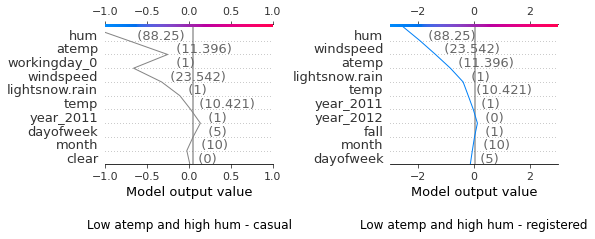

In [154]:
# Compare two SHAP decision plots next to each other
plt.figure(figsize=(5,5))
plt.subplot(2,2,1)
shap.decision_plot(explainer1_shap.expected_value, shap_lahh_values1, Xdf_lahh_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-1.0, 1.0), show=False)
plt.title("Low atemp and high hum - casual", y=-0.5)
plt.subplot(2,2,2)
shap.decision_plot(explainer2_shap.expected_value, shap_lahh_values2, Xdf_lahh_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-3.0, 3.0), show=False)
plt.title("Low atemp and high hum - registered", y=-0.5)
plt.tight_layout()
plt.show()

Based on the shap plots, the casual customer model predicted -1.18, which shows a negative rent prediction on this day.

The renting prediction is negatively affected by not clear sky, year 2011, low temperature, light snow or rain, high wind speed, low feeling temperature and high humidity.

Month which is near to the end of the year, day of week in the middle of the week and Not working day raise the rent prediction, but not enough to push the scales toward positive.

Based on the shap plots, the registered customer model predicted -2.54, which shows a negative rent prediction on this day.

The renting prediction is negatively affected mostly by year 2011, low temperature, light snow or rain, low feeling temperature, high wind speed and high humidity.

Day of week in the middle of the week, Month which is near to the end of the year, and fall raise the rent prediction, but not enough to push the scales toward positive.

On a day with low feeling temperature and high humidity, low feeling temperature, high humidity, year 2011, low temperature, light snow or rain, high wind speed are the features that affects negative rent prediction for both casual and registered customers. Month which is near to the end of the year, day of week in the middle of the week are the features that affects positive rent prediction for both casual and registered customers.

For casual customers, not clear sky affects the rent negatively, but for registered customers it has no effect. For casual customers, not working day affects the rent positively. But, for registered customers, fall affects the rent positively.

# Low feeling temperature and low humidity

Here, I am going to compare the behaviour of the casual and registered customers on low feeling temperature and low humidity.

In [155]:
shap_lalh_values1 = explainer1_shap.shap_values(Xdf_lalh)
shap_lalh_values2 = explainer2_shap.shap_values(Xdf_lalh)

In [156]:
# Plotting the force plot for casual customers
shap.force_plot(explainer1_shap.expected_value, shap_lalh_values1, Xdf_lalh_original, feature_names=NAMES)

In [157]:
# Plotting the force plot for registered customers
shap.force_plot(explainer2_shap.expected_value, shap_lalh_values2, Xdf_lalh_original, feature_names=NAMES)

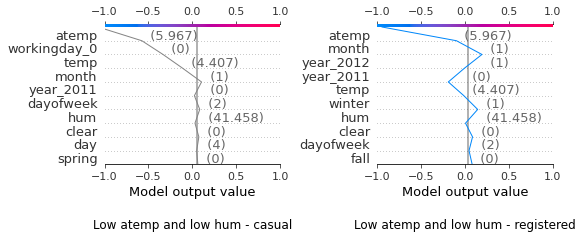

In [158]:
# Compare two SHAP decision plots next to each other
plt.figure(figsize=(5,5))
plt.subplot(2,2,1)
shap.decision_plot(explainer1_shap.expected_value, shap_lalh_values1, Xdf_lalh_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-1.0, 1.0), show=False)
plt.title("Low atemp and low hum - casual", y=-0.5)
plt.subplot(2,2,2)
shap.decision_plot(explainer2_shap.expected_value, shap_lalh_values2, Xdf_lalh_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-1.0, 1.0), show=False)
plt.title("Low atemp and low hum - registered", y=-0.5)
plt.tight_layout()
plt.show()

Based on the shap plots, the casual customer model predicted -1.07, which shows a negative rent prediction on this day.

The renting prediction is negatively affected by spring, not clear sky, day of week in the start of the week, month which is near to the start of the year, low temperature, working day and low feeling temperature.

Day which is near to the start of the week, less humidity and Year 2012 raise the rent prediction, but not enough to push the scales toward positive.

Based on the shap plots, the registered customer model predicted -0.95, which shows a negative rent prediction on this day.

The renting prediction is negatively affected by not fall, not clear sky, winter, low temperature, the month near to the start of the year, and low feeling temperature.

Day of week, which is near to the start of the week, low humidity and year 2012 raise the rent prediction, but not enough to push the scales toward positive.

On a day with low feeling temperature and low humidity, low feeling temperature, low temperature, not clear sky and month near the start of the year are the features that affects negative rent prediction for both casual and registered customers. Year 2012 and less humidity are the features that affects positive rent prediction for both casual and registered customers.

For casual customers, spring, day of week in the start of the week and working day affects the rent negatively. But for registered customers, not fall affects the rent negatively.
For casual customers Day which is near to the start of the week affects the rent positively, but for registered customers, day of week which is near to the start of the week affects the rent positively.

# High feeling temperature and low humidity

Here, I am going to compare the behaviour of the casual and registered customers on high feeling temperature and low humidity.

In [159]:
shap_halh_values1 = explainer1_shap.shap_values(Xdf_halh)
shap_halh_values2 = explainer2_shap.shap_values(Xdf_halh)

In [160]:
# Plotting the force plot for casual customers
shap.force_plot(explainer1_shap.expected_value, shap_halh_values1, Xdf_halh_original, feature_names=NAMES)

In [161]:
# Plotting the force plot for registered customers
shap.force_plot(explainer2_shap.expected_value, shap_halh_values2, Xdf_halh_original, feature_names=NAMES)

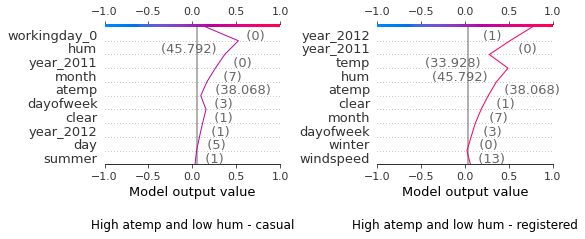

In [162]:
# Compare two SHAP decision plots next to each other
plt.figure(figsize=(5,5))
plt.subplot(2,2,1)
shap.decision_plot(explainer1_shap.expected_value, shap_halh_values1, Xdf_halh_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-1.0, 1.0), show=False)
plt.title("High atemp and low hum - casual", y=-0.5)
plt.subplot(2,2,2)
shap.decision_plot(explainer2_shap.expected_value, shap_halh_values2, Xdf_halh_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-1.0, 1.0), show=False)
plt.title("High atemp and low hum - registered", y=-0.5)
plt.tight_layout()
plt.show()

Based on the shap plots, the casual customer model predicted 0.15, which shows a positive rent prediction on this day.

The renting prediction is positive affected by summer, day which is near to the end of the week, year 2012, clear sky, high feeling temperature, month which is middle of the year and low humidity.

Working day and day of week in the middle of the week reduce the rent prediction, but not enough to push the scales toward negative.

Based on the shap plots, the registered customer model predicted 0.76, which shows a positive rent prediction on this day.

The renting prediction is positive affected by not winter, day of week in the middle of the week, month which is middle of the year, clear sky, high feeling temperature, low humidity and year 2012.

Average windspeed and high temperature reduce the rent prediction, but not enough to push the scales toward negative.

On a day with high feeling temperature and low humidity, high feeling temperature, less humidity, year 2012, month near the middle of the year and clear sky are the features that affects positive rent prediction for both casual and registered customers.

For casual customers, day which is near to the end of the week affects the rent positively, but for registered customers, not winter and day of week in the middle of the week affects the rent positively. For casual customers, working day, day of week in the middle of the week affects the rent negatively. But, for registered customers, average windspeed and high temperature affects the rent negatively.

# High feeling temperature and average humidity

Here, I am going to compare the behaviour of the casual and registered customers on high feeling temperature and average humidity.

In [163]:
shap_haah_values1 = explainer1_shap.shap_values(Xdf_haah)
shap_haah_values2 = explainer2_shap.shap_values(Xdf_haah)

In [164]:
# Plotting the force plot for casual customers
shap.force_plot(explainer1_shap.expected_value, shap_haah_values1, Xdf_haah_original, feature_names=NAMES)

In [165]:
# Plotting the force plot for registered customers
shap.force_plot(explainer2_shap.expected_value, shap_haah_values2, Xdf_haah_original, feature_names=NAMES)

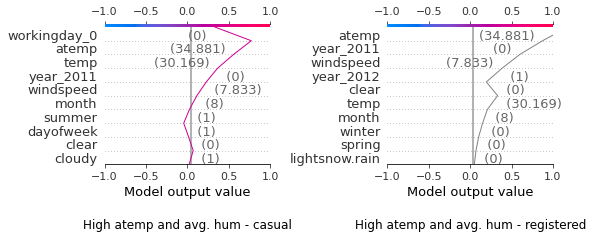

In [166]:
# Compare two SHAP decision plots next to each other
plt.figure(figsize=(5,5))
plt.subplot(2,2,1)
shap.decision_plot(explainer1_shap.expected_value, shap_haah_values1, Xdf_haah_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-1.0, 1.0), show=False)
plt.title("High atemp and avg. hum - casual", y=-0.5)
plt.subplot(2,2,2)
shap.decision_plot(explainer2_shap.expected_value, shap_haah_values2, Xdf_haah_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-1.0, 1.0), show=False)
plt.title("High atemp and avg. hum - registered", y=-0.5)
plt.tight_layout()
plt.show()

Based on the shap plots, the casual customer model predicted 0.33, which shows a positive rent prediction on this day.

The renting prediction is positive affected by cloudy day, summer, month near to the middle of the year, low wind speed, year 2012, high temperature and high feeling temperature.

Not clear sky, day of week in the beginning of the week and working day reduce the rent prediction, but it is not enough to push the scales toward negative.

Based on the shap plots, the registered customer model predicted 1.19, which shows a positive rent prediction on this day.

The renting prediction is positive affected by no light snow or rain, not spring, not winter, month near to the middle of the year, high temperature, year 2012, low wind speed and high feeling temperature.

Not clear sky is the only feature that reduce the rent prediction, but it is so negligible enough to push the scales toward negative.

On a day with high feeling temperature and average humidity, high feeling temperature, year 2012, high temperature, month near the middle of the year and low wind speed are the features that affects positive rent prediction for both casual and registered customers. Not clear sky affects negative rent prediction for both casual and registered customers

For casual customers, features cloudy day and summer affects the rent positively, but for registered customers, no light snow or rain, not spring and not winter affects the rent positively. For casual customers, day of week in the beginning of the week and working day affects the rent negatively. But, for registered customers, it has no effect.

# Question 4

B-4. Find two day-instances for bike renting on a working day and weekend targeting a casual user and two other days for bike renting on a working day and weekend targeting a registered user. Note that the model for a casual user and a registered user is different since the targets are different. Given the four instances, show the four LIME visualizations. The four instances are categorized as ‘a working day/casual user’, ‘a working day/registered user’, ‘a weekend/casual user’, and ‘a weekend/registered user’.

Initially, I am going to study the behaviour of the casual customer on a working day.

In [167]:
# Select from the test set
# Get the instance of a working day
test = X_test1[X_test1['workingday_1'] == 1]
test

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
404,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,-1.259444,-1.304061,-0.462378,0.045849,-1.310268,-0.765422,-0.001366
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,-1.318665,-1.521108,0.175807,2.061426,1.588660,1.279122,-0.001366
159,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.710794,1.739181,-0.418467,-0.524286,-0.150697,-0.765422,-0.001366
422,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,-0.703661,-0.714770,-0.962970,1.001316,-1.310268,1.279122,-1.498809
241,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.786014,0.739025,-0.558984,-0.845482,0.429089,1.619879,-0.999661
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
675,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,-1.172890,-1.183834,-0.427249,-0.219165,1.298767,-1.106179,-0.999661
713,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,-1.168331,-1.106309,0.105549,-0.765154,1.588660,-0.197493,0.497782
40,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.919012,-1.994514,-1.338445,0.406080,-1.310268,-0.651836,-0.001366
432,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.175564,0.308567,-0.424319,3.242008,-1.020375,-0.879008,-0.001366


In [168]:
PICK = 404
Xdf_wd = Xdf[Xdf.index==PICK]
Xdf_wd_original = X_original[X_original.index==PICK]
Xdf_wd

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
404,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,-1.259444,-1.304061,-0.462378,0.045849,-1.310268,-0.765422,-0.001366


In [169]:
# Get the total bike rental count for casual customers on this instance
print("target count is:", y1[PICK])

target count is: 163


We can see there are only 163 rental count on this instance, which is very low compared to mean of casual customers, which was 848. So, the plot should show a negative rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [170]:
# Explain one day of a working day for the casual customer. Target count: 163
print("Lime plot of casual customers on a working day")
#Explanation object has information about features contributions to this particular prediction
exp_casual_wd = explainer1.explain_instance(Xdf_wd.values[0], xgbmodel1.predict)#, num_features=10)
exp_casual_wd.show_in_notebook(show_all=False)

Lime plot of casual customers on a working day
Intercept 0.7349341325379141
Prediction_local [-0.84439923]
Right: -1.0472827


Based on the local model, the prediction value showed -0.844 while the actual model predicted -1.047, which is aligned and shows a negative rent prediction on this day.

The renting prediction is negatively affected mostly by working day. It also affected negatively by low feeling temperature, low temperature, day of week in the middle of the week, month near to the start of the year, and not holiday.

Year 2012, no light snow or rain, average humidity and clear sky raise the rent prediction, but not enough to push the scales toward positive.

Now, I am going to study the behaviour of registered customers on the same instance.

In [171]:
# Get the total bike rental count for registered customers on this instance
print("target count is:", y2[PICK])

target count is: 3667


We can see there are 3667 rental count on this instance, which is just above the mean of registered customers, which was 3656. So, we cannot predict the behaviour of plot in this case. Now, I am going to plot the LIME model for the same instance.

In [172]:
# Explain one day of a working day for the casual customer. Target count: 3667
print("Lime plot of registered customers on a working day")
#Explanation object has information about features contributions to this particular prediction
exp_registered_wd = explainer2.explain_instance(Xdf_wd.values[0], xgbmodel2.predict)#, num_features=10)
exp_registered_wd.show_in_notebook(show_all=False)

Lime plot of registered customers on a working day
Intercept -0.8029789241377641
Prediction_local [-0.53280657]
Right: -0.41070333


Based on the local model, the prediction value showed -0.533 while the actual model predicted -0.411, which is aligned and shows a negative rent prediction on this day.

The renting prediction is negatively affected mostly by low feeling temperature. It also affected negatively by low temperature, month near to the start of the year, winter and not holiday.

No light snow or rain, year 2012, average humidity and clear sky raise the rent prediction, but not enough to push the scales toward positive.

Now, I am going to study the behaviour of the casual customer on a weekend.

In [173]:
# Select from the test set
# Get the instance of weekend (Saturday and Sunday)
test = X_test1[X_test1['dayofweek'] >= 0.99]
test

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
512,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.063903,1.025922,0.486111,0.318740,-0.440589,1.279122,1.496077
120,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-0.238992,-0.160577,0.942791,-1.086350,-0.440589,-1.674108,1.496077
8,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,-1.951895,-2.199446,-1.361096,2.214012,-1.600161,-0.765422,1.496077
364,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,-0.466773,-0.369869,-0.084739,0.383083,1.588660,1.733465,0.996930
259,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-0.020324,0.025533,0.635410,-0.010475,0.718982,0.143264,0.996930
414,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,-1.177444,-1.280727,-0.787324,0.808650,-1.310268,0.370436,1.496077
161,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.255237,1.250749,0.187512,-0.460150,-0.150697,-0.538250,0.996930
434,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,-1.136444,-1.207168,-1.949511,0.455341,-1.020375,-0.651836,0.996930
581,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.628793,1.700421,-0.102304,0.864768,0.429089,-1.333351,0.996930
421,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,-1.181998,-1.265253,-1.530890,0.190365,-1.310268,1.165536,1.496077


In [174]:
# Picking an instance of a weekend
PICK = 364
Xdf_we = Xdf[Xdf.index==PICK]
Xdf_we_original = X_original[X_original.index==PICK]
Xdf_we

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
364,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,-0.466773,-0.369869,-0.084739,0.383083,1.58866,1.733465,0.99693


In [175]:
# Get the total bike rental count for casual customers on this instance
print("target count is:", y1[PICK])

target count is: 665


We can see there are only 665 rental count on this instance, which is little low compared to mean of casual customers, which was 848. So, the plot should show a negative rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [176]:
# Explain one instance of a weekend day for the casual customer. Target count: 665
print("Lime plot of casual customers on a weekend")
#Explanation object has information about features contributions to this particular prediction
exp_casual_we = explainer1.explain_instance(Xdf_we.values[0], xgbmodel1.predict)#, num_features=10)
exp_casual_we.show_in_notebook(show_all=False)

Lime plot of casual customers on a weekend
Intercept -0.2760729015122757
Prediction_local [0.8276606]
Right: 0.2250383


Based on the local model, the prediction value showed 0.836 while the actual model predicted 0.225, which is aligned and shows a positive rent prediction on this day.

The renting prediction is positive affected mostly by not working day. It also affected positive by no light snow or rain, day of week in the middle of the week, clear sky and average humidity.

Year 2011, month near to the end of the year, not holiday, and medium temperature reduce the rent prediction, but it is not enough to push the scales toward negative.

Now, I am going to study the behaviour of registered customers on the same instance.

In [177]:
# Get the total bike rental count for registered customers on this instance
print("target count is:", y2[PICK])

target count is: 1820


We can see there are 1820 rental count on this instance, which is less than the mean of registered customers, which was 3656. So, the plot should show a negative rent prediction on this day. Now, I am going to plot the LIME model for the same instance.

In [178]:
# Explain one instance of a weekend day for the registered customers. Target count: 1820
print("Lime plot of registered customers on a weekend")
#Explanation object has information about features contributions to this particular prediction
exp_casual_we = explainer2.explain_instance(Xdf_we.values[0], xgbmodel2.predict)#, num_features=10)
exp_casual_we.show_in_notebook(show_all=False)

Lime plot of registered customers on a weekend
Intercept -0.2955403794730934
Prediction_local [-0.54985429]
Right: -0.6185742


Based on the local model, the prediction value showed -0.455 while the actual model predicted -0.619, which is aligned and shows a negative rent prediction on this day.

The renting prediction is negatively affected mostly by year 2011. It also affected negatively by winter, medium feeling temperature and not fall. 

No light snow or rain, average humidity, clear sky, month near to the end of the year, and medium temperature raise the rent prediction, but not enough to push the scales toward positive.

# Question 5

B-5. Based on ‘B-4’, compare the results of ‘casual’ users and ‘registered’ users and describe the similarities and differences.

Based on the single instance LIME explanation in this example and your comparison analysis, if you are the CEO of this bike rental company, what is your marketing strategy based on the findings?

# Explanation

# Working day

On a working day, low feeling temperature, low temperature, month near to the start of the year, and not holiday are the features that affects negative rent prediction for both casual and registered customers. Year 2012, no light snow or rain, average humidity and clear sky are the features that affects positive rent prediction for both casual and registered customers.

For casual customers working day, and day of week in the middle of the week affects the rent negatively, but for registered customers winter affects the rent negatively.

# Weekend

On a weekend, year 2011, medium temperature are the features that affects negative rent prediction for both casual and registered customers. No light snow or rain, clear sky, and average humidity affects positive rent prediction for both casual and registered customers.

Casual customers have positive rental prediction while registered customers have negative rental prediction. For casual customers, month near to the end of the year, not holiday and medium temperature affects the rent negatively, but for registered customers, winter, medium feeling temperature and not fall affects the rent negatively. For casual customers, not working day and day of week near the middle of the weak affects the rent positively. But for registered customers, month near to the end of the year and medium temperature affects the rent positively.

# Marketing strategy

From the plots, we can see when there is low and medium temperature, low feeling temperature, month near to the start of the year, and not holiday people are less likely renting the bike for both casual and registered customers. So, as the CEO of the company, I will give special discount for both casual and registered customers in these conditions.

Also, from the plot we can see for casual customers, working day, day of week in the middle of the week, month near to the end of the year, not holiday affects the rental behaviour negatively. So, as the CEO of the company, I will give special discount for casual customers in these conditions.

Also, from the plot we can see for registered customers, winter, medium feeling temperature and not fall affects the rental behaviour negatively. So, as the CEO of the company, I will give special discount for registered customers in the season other than fall, and when the feeling temperature is medium.

# Question 6

B-6. Based on ‘B-4’, use SHAP for local explanations and describe the similarities and differences.

# Working day

Here, I am going to compare the behaviour of the casual and registered customers on a working day.

In [179]:
shap_wd_values1 = explainer1_shap.shap_values(Xdf_wd)
shap_wd_values2 = explainer2_shap.shap_values(Xdf_wd)

In [180]:
# Plotting the force plot for casual customers
shap.force_plot(explainer1_shap.expected_value, shap_wd_values1, Xdf_wd_original, feature_names=NAMES)

In [181]:
# Plotting the force plot for registered customers
shap.force_plot(explainer2_shap.expected_value, shap_wd_values2, Xdf_wd_original, feature_names=NAMES)

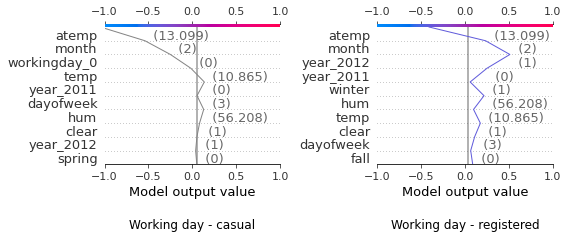

In [182]:
# Compare two SHAP decision plots next to each other
plt.figure(figsize=(5,5))
plt.subplot(2,2,1)
shap.decision_plot(explainer1_shap.expected_value, shap_wd_values1, Xdf_wd_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-1.0, 1.0), show=False)
plt.title("Working day - casual", y=-0.5)
plt.subplot(2,2,2)
shap.decision_plot(explainer2_shap.expected_value, shap_wd_values2, Xdf_wd_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-1.0, 1.0), show=False)
plt.title("Working day - registered", y=-0.5)
plt.tight_layout()
plt.show()

Based on the shap plots, the casual customer model predicted -1.05, which shows a negative rent prediction on this day.

The renting prediction is negatively affected by not spring, day of week in the middle of the week, low temperature, working day, month near to the start of the year and low feeling temperature.

Year 2012, clear sky and average humidity raise the rent prediction, but not enough to push the scales toward positive.

Based on the shap plots, the registered customer model predicted -0.41, which shows a negative rent prediction on this day.

The renting prediction is negatively affected by not fall, low temperature, winter, month near to the start of the year and low feeling temperature.

Day of week in the middle of the week, clear sky, average humidity and year 2012 raise the rent prediction, but not enough to push the scales toward positive.

On a working day, low feeling temperature, low temperature, and month near to the start of the year are the features that affects negative rent prediction for both casual and registered customers. Year 2012, average humidity and clear sky are the features that affects positive rent prediction for both casual and registered customers.

For casual customers not spring, day of week in the middle of the week, and working day affects the rent negatively, but for registered customers not fall, and winter affects the rent negatively. For registered customers, day of week in the middle of the week, affects the rent positively. But, for casual customers, it has no effect.

# Weekend

Here, I am going to compare the behaviour of the casual and registered customers on a weekend.

In [183]:
shap_we_values1 = explainer1_shap.shap_values(Xdf_we)
shap_we_values2 = explainer2_shap.shap_values(Xdf_we)

In [184]:
# Plotting the force plot for casual customers
shap.force_plot(explainer1_shap.expected_value, shap_we_values1, Xdf_we_original, feature_names=NAMES)

In [185]:
# Plotting the force plot for registered customers
shap.force_plot(explainer2_shap.expected_value, shap_we_values2, Xdf_we_original, feature_names=NAMES)

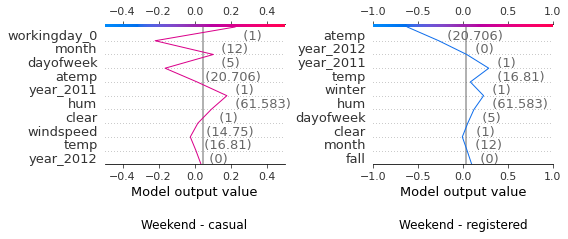

In [186]:
# Compare two SHAP decision plots next to each other
plt.figure(figsize=(5,5))
plt.subplot(2,2,1)
shap.decision_plot(explainer1_shap.expected_value, shap_we_values1, Xdf_we_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-0.5, 0.5), show=False)
plt.title("Weekend - casual", y=-0.5)
plt.subplot(2,2,2)
shap.decision_plot(explainer2_shap.expected_value, shap_we_values2, Xdf_we_original, feature_display_range=slice(None, -11, -1), feature_names=NAMES.values, xlim=(-1.0, 1.0), show=False)
plt.title("Weekend - registered", y=-0.5)
plt.tight_layout()
plt.show()

Based on the shap plots, the casual customer model predicted 0.23, which shows a positive rent prediction on this day.

The renting prediction is positive affected by medium wind speed, clear sky, average humidity, day of week in the middle of the week, and not working day.

Year 2011, medium temperature, medium feeling temperature, and month near to the end of the year reduce the rent prediction, but it is not enough to push the scales toward negative.

Based on the shap plots, the registered customer model predicted -0.62, which shows a negative rent prediction on this day.

The renting prediction is negatively affected mostly by not fall, month near to the end of the year, winter, year 2011 and medium feeling temperature. 

Clear sky, day of week in the middle of the week, average humidity, and medium temperature raise the rent prediction, but not enough to push the scales toward positive.

On a weekend, year 2011, medium feeling temperature, and month near to the end of the year are the features that affects negative rent prediction for both casual and registered customers. Clear sky, day of week in the middle of the week, and average humidity affects positive rent prediction for both casual and registered customers.

Casual customers have positive rental prediction while registered customers have negative rental prediction. For casual customers, medium temperature affects the rent negatively, but for registered customers, not fall and winter affects the rent negatively. For casual customers, medium wind speed, and not working day affects the rent positively. But for registered customers, medium temperature affects the rent positively.

# Reflection

# Question 7

B-7. (Reflection) After analyzing and comparing the results of LIME and SHAP, what are the advantages of post-hoc explanation and LIME and SHAP, respectively?

# Advantages of Post-hoc Explanations

Post-hoc explanations are not tied to any specific machine learning model. This means they can be applied to a wide range of models, making them versatile and applicable in many scenarios. Post-hoc methods can provide human-understandable explanations for model predictions, making it easier for users to understand why a model made a particular prediction. They can help identify issues and errors in machine learning models, leading to improved trust in model predictions and decision-making. In contexts where regulatory compliance is crucial, post-hoc explanations can help ensure that models are transparent and compliant with relevant regulations.

# Advantages of LIME

LIME focuses on providing local interpretations for individual predictions. It helps users understand why a specific prediction was made, which can be especially useful when you need to know why a model made a particular decision for a single data point. LIME uses simple, interpretable surrogate models to approximate the behavior of the complex underlying model. This makes the explanations more understandable and intuitive. LIME allows you to select the level of granularity for the explanation, from individual predictions to a set of predictions, making it adaptable to different use cases.

# Advantages of SHAP

SHAP is capable of providing both global and local explanations. It can help you understand the overall impact of features on model predictions (global) as well as how specific features influenced a particular prediction (local). Like other post-hoc techniques, SHAP is model-agnostic, making it suitable for a wide range of machine learning models, including deep learning, ensemble methods, and more. SHAP values are based on the concept of Shapley values from cooperative game theory, which ensures consistency and fairness in attributing contributions of features to predictions. SHAP values can help users understand the importance of individual features in the model's predictions. This can be valuable for feature selection, model refinement, and understanding the factors driving predictions.

# Question 8

B-8. (Reflection) After analyzing and comparing the results of LIME and SHAP, what are the disadvantages of post-hoc explanation and LIME and SHAP, respectively?

# Disadvantages of Post-hoc Explanations

Post-hoc explanations often rely on simplified surrogate models to approximate the behavior of the complex underlying model. This simplification may lead to a loss of fidelity and accuracy in the explanations. Creating surrogate models for large or complex machine learning models can be computationally intensive, especially when you need to explain a large number of predictions or features. Some post-hoc methods assume that the features are independent, which may not be the case in real-world data. This can result in less accurate explanations.

# Disadvantages of LIME

LIME explanations can be unstable or sensitive to the choice of random perturbations, which can lead to different explanations for similar data points. LIME provides local explanations, which means it may not capture the broader trends and patterns in the data or model behavior. The choice of the neighborhood around a data point and the complexity of the surrogate model in LIME are user-dependent, which can introduce subjectivity in the explanations.

# Disadvantages of SHAP

Calculating SHAP values can be computationally expensive, particularly for models with a large number of features or complex interactions. While SHAP values provide a consistent and theoretically grounded approach to feature attribution, interpreting these values can be challenging for non-technical users. SHAP values can reveal feature interactions, but interpreting these interactions may still be complex and require domain expertise. SHAP values may not scale well to high-dimensional feature spaces, and the interpretation can become challenging as the number of features increases. While SHAP can provide both local and global explanations, the focus on feature-level attributions may lead to a neglect of broader model behavior and patterns.

# Question 9

B-9. (Reflection) How much can you trust the results of LIME and SHAP? List the current limitations arising from post-hoc explanations (refer to the articles below and cite them).

# 1. Robustness

The results of LIME and SHAP are not very robust with respect to local perturbations of the input (Alvarez et al., 2018). The authors show that these methods produce different explanations for inputs that are slightly modified or reordered. They also propose some ways to improve the robustness of these methods, such as using regularization or aggregation techniques (Alvarez et al., 2018).

# 2. Adversarial attacks

LIME and SHAP can be fooled by scaffolding techniques that create a biased classifier with a desired explanation (Slack et al., 2020). LIME and SHAP can also be fooled by perturbation techniques that modify the input features or labels to change the explanation. Some proposed defenses against these attacks are using robust perturbations, adversarial training, and explanation verification (Slack et al., 2020).

# 3. Manipulable

LIME and SHAP can be fooled by adversarial examples that change the explanations without changing the predictions significantly (Dombrowski et al., 2019). LIME and SHAP are sensitive to geometric properties of the input space, such as curvature, dimensionality, and sparsity. Some metrics also proposed to measure the manipulability of explanations, such as stability, sensitivity, and robustness. Some countermeasures also suggested to reduce the manipulability of explanations, such as using different perturbation methods, aggregating multiple explanations, and verifying the explanations with additional data (Dombrowski et al., 2019).

# 4. Unjustified Counterfactual Explanations

LIME and SHAP can generate counterfactual examples that are not connected to any ground-truth data, meaning that they are artificial and unrealistic (Laugel et al., 2019). LIME and SHAP do not consider the geometry of the input space, such as the boundaries, clusters, and density of the data points. Some metrics also proposed to measure the justifiability of counterfactual examples, such as the distance to the nearest neighbor, the density of the neighborhood, and the consistency of the prediction. Some guidelines also suggested to improve the quality of counterfactual explanations, such as using multiple methods, verifying the results, and informing the users about the limitations (Laugel et al., 2019).

# 5. Faithfulness

LIME and SHAP are post-hoc methods that do not have access to the internal logic of the black box models, and therefore can only provide approximate explanations that may not reflect the true decision process of the models (Rudin et al., 2019). LIME and SHAP rely on local perturbations of the input data to generate explanations, but these perturbations may not be meaningful or valid in the context of the problem domain, and may introduce noise or bias that can affect the quality of the explanations. LIME and SHAP do not account for the complexity or uncertainty of the black box models, and may produce explanations that are too simplistic or overconfident, and thus fail to capture the nuances or trade-offs of the models. LIME and SHAP do not guarantee that their explanations are consistent, stable, or robust across different inputs, models, or settings, and may produce explanations that are contradictory, incoherent, or fragile, and thus undermine the trustworthiness of the models (Rudin et al., 2019).

# Question 10

B-10. (Reflection) Considering the limitations described above, what and how can LIME and SHAP be refined to improve trustworthiness?

Using regularization or aggregation techniques to enhance the robustness of the explanations against local perturbations or adversarial attacks. Considering the geometry of the input space, such as the boundaries, clusters, and density of the data points, to generate more realistic and justifiable counterfactual examples. Using adversarial training, robust perturbations, or explanation verification methods to defend against scaffolding or perturbation attacks that manipulate the explanations. Using interpretable models instead of black-box models, or using global explanations instead of local explanations, to increase the faithfulness and consistency of the explanations. Informing the users about the limitations, uncertainties, and assumptions of the explanation methods, and providing them with multiple or alternative explanations when possible.

# References

David Alvarez-Melis and Tommi S. Jaakkola (2018). On the Robustness of Interpretability Methods. CoRR, abs/1806.08049.

Dylan Slack and Sophie Hilgard and Emily Jia and Sameer Singh and Himabindu Lakkaraju (2020). Fooling LIME and SHAP: Adversarial Attacks on Post hoc Explanation Methods. In AIES (pp. 180–186). ACM.

Ann-Kathrin Dombrowski and Maximilian Alber and Christopher J. Anders and Marcel Ackermann and Klaus-Robert Müller and Pan Kessel (2019). Explanations can be manipulated and geometry is to blame. In NeurIPS (pp. 13567–13578).

Thibault Laugel and Marie-Jeanne Lesot and Christophe Marsala and Xavier Renard and Marcin Detyniecki (2019). The Dangers of Post-hoc Interpretability: Unjustified Counterfactual Explanations. In IJCAI (pp. 2801–2807). ijcai.org.

Cynthia Rudin (2019). Stop explaining black box machine learning models for high stakes decisions and use interpretable models instead. Nature